# Libraries

In [ ]:
import pandas as pd
import requests
from io import BytesIO
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import itertools
import more_itertools

# Reading the Data

In [ ]:
def read_order_types_for_df(file_content):
    dtype = 'uint8'
    points = file_content.reshape(-1, 2)
    df = pd.DataFrame(points, columns=['x', 'y'], dtype=dtype)
    return df

def read_order_types(file_content):
    dtype = 'uint8'
    points = file_content.reshape(-1, 2)
    return points

In [ ]:
file_url = "http://www.ist.tugraz.at/staff/aichholzer/research/rp/triangulations/ordertypes/data/otypes08.b08"

# downloading set points
response = requests.get(file_url)
file_content = response.content

# Use BytesIO to create a file-like object from the bytes content
file_like_object = BytesIO(file_content)

In [ ]:
# Reading content into data frame
file_content_array = np.frombuffer(file_like_object.getvalue(), dtype=np.uint8)
df = read_order_types_for_df(file_content_array)
df.head()

,x,y
0,218,48
1,157,54
2,88,66
3,76,72
4,61,90


In [ ]:
# Reading content into matrix
data = read_order_types(file_content_array)
data = list(data)
data = [list(x) for x in data]
data[:5]

[[218, 48], [157, 54], [88, 66], [76, 72], [61, 90]]

# Funcrions to Plot

In [ ]:
def generate_edges(vertices):
  edges = []
  for u in range(len(vertices)):
    for v in range(u+1,len(vertices)):
      if u != v: edges.append((vertices[u],vertices[v]))
  return edges

In [ ]:
def plot_edges(components, vertices_data, save_path=None):

    edges_data = generate_edges(vertices_data)
    edge_styles = ['-', '--', '-.', ':', (0, (3, 1, 1, 1, 1, 1))]
    edge_colors = ['b', 'g', 'r', 'm', 'c', 'k']
    vertex_marker = 'ko'

    fig, ax = plt.subplots(figsize=(8, 8))

    for i, component in enumerate(components):
        for j, edge_idx in enumerate(component):
            edge = edges_data[edge_idx]
            x, y = zip(edge[0], edge[1])
            style = edge_styles[i % len(edge_styles)]
            color = edge_colors[i % len(edge_colors)]
            ax.plot(x, y, linestyle=style, linewidth=3, color=color, marker='o')

        for edge_idx in component:
            for vertex in edges_data[edge_idx]:
                ax.plot(vertex[0], vertex[1], vertex_marker)

    ax.set_axis_off()

    if save_path:
        plt.savefig(save_path, format='svg', bbox_inches='tight')
    plt.show()

# Generating the Pictures

We first import the contents of the ```8-5-partitions.txt``` file, where we have stored all the point sets admitting plane star-forest decompositions.

In [ ]:
partitions = [[[[3, 1], [50, 254], [79, 187], [120, 128], [21, 15], [123, 61], [172, 18], [252, 10]], [[1, 11, 21, 22], [0, 3, 6, 13, 15, 16], [7, 8, 10, 5, 23, 27], [2, 19, 20, 12, 17, 24], [4, 9, 14, 18, 25, 26]]],
[[[253, 83], [3, 56], [21, 67], [31, 88], [238, 86], [157, 125], [107, 160], [64, 200]], [[1, 11, 21, 22], [0, 3, 6, 13, 15, 16], [7, 8, 10, 5, 23, 27], [2, 19, 20, 12, 17, 24], [4, 9, 14, 18, 25, 26]]],
[[[17, 239], [242, 170], [194, 161], [122, 188], [77, 189], [81, 177], [38, 63], [14, 16]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[15, 10], [94, 245], [105, 215], [97, 190], [108, 146], [117, 52], [200, 75], [241, 38]], [[2, 10, 17, 23], [0, 1, 5, 18, 19, 21], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [3, 11, 16, 20, 22, 24]]],
[[[237, 160], [18, 67], [69, 134], [103, 143], [102, 151], [119, 164], [82, 176], [80, 188]], [[1, 11, 21, 22], [0, 3, 6, 13, 15, 16], [7, 8, 10, 5, 23, 27], [2, 19, 20, 12, 17, 24], [4, 9, 14, 18, 25, 26]]],
[[[186, 234], [244, 21], [168, 39], [174, 144], [156, 128], [146, 146], [80, 38], [5, 30]], [[1, 12, 20, 22], [0, 3, 5, 13, 15, 17], [7, 8, 10, 6, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[5, 29], [99, 237], [129, 184], [67, 102], [132, 162], [145, 118], [222, 40], [251, 19]], [[1, 12, 20, 22], [0, 3, 5, 13, 15, 17], [7, 8, 10, 6, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[3, 30], [174, 226], [173, 212], [162, 191], [157, 149], [147, 126], [224, 74], [252, 32]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[240, 18], [15, 144], [55, 147], [196, 59], [207, 110], [216, 98], [195, 221], [208, 238]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[43, 222], [246, 92], [200, 99], [73, 186], [70, 160], [59, 179], [77, 83], [1, 29]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[189, 253], [140, 2], [127, 107], [159, 228], [129, 225], [144, 238], [91, 229], [67, 236]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[246, 101], [9, 25], [122, 147], [147, 140], [190, 134], [149, 170], [140, 202], [128, 230]], [[2, 10, 17, 23], [0, 1, 5, 18, 19, 21], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [3, 11, 16, 20, 22, 24]]],
[[[1, 2], [44, 254], [65, 216], [63, 178], [80, 49], [108, 58], [219, 60], [255, 46]], [[2, 10, 17, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [5, 9, 14, 18, 25, 27]]],
[[[10, 235], [251, 100], [198, 113], [134, 145], [46, 203], [24, 170], [18, 106], [5, 34]], [[5, 10, 17, 18], [0, 2, 6, 16, 23, 25], [8, 11, 12, 4, 15, 22], [1, 7, 13, 24, 26, 27], [3, 9, 14, 19, 20, 21]]],
[[[162, 193], [253, 120], [226, 124], [209, 137], [175, 173], [135, 156], [66, 93], [3, 63]], [[4, 11, 13, 24], [2, 5, 6, 10, 15, 22], [0, 8, 12, 16, 23, 25], [1, 7, 14, 19, 20, 21], [3, 9, 17, 18, 26, 27]]],
[[[99, 232], [255, 21], [234, 33], [202, 70], [104, 216], [65, 167], [23, 103], [2, 102]], [[5, 10, 17, 18], [0, 1, 2, 23, 25, 27], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [3, 9, 14, 19, 20, 21]]],
[[[23, 82], [112, 205], [128, 158], [120, 140], [69, 103], [133, 117], [180, 80], [241, 51]], [[2, 10, 17, 23], [0, 1, 5, 18, 19, 21], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [3, 11, 16, 20, 22, 24]]],
[[[5, 40], [143, 243], [129, 187], [116, 166], [23, 52], [88, 67], [219, 60], [251, 33]], [[2, 10, 17, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [5, 9, 14, 18, 25, 27]]],
[[[175, 214], [252, 61], [229, 75], [168, 158], [167, 170], [147, 168], [42, 59], [5, 43]], [[4, 8, 17, 23], [2, 5, 6, 10, 15, 22], [0, 7, 11, 18, 19, 21], [1, 13, 16, 12, 24, 26], [3, 9, 14, 20, 25, 27]]],
[[[173, 3], [7, 98], [55, 114], [148, 57], [161, 34], [195, 132], [219, 223], [249, 253]], [[4, 8, 17, 23], [2, 5, 6, 10, 15, 22], [0, 7, 11, 18, 19, 21], [1, 13, 16, 12, 24, 26], [3, 9, 14, 20, 25, 27]]],
[[[255, 143], [1, 81], [48, 108], [134, 132], [202, 142], [149, 147], [110, 156], [109, 175]], [[1, 11, 21, 22], [0, 3, 6, 13, 15, 16], [7, 8, 10, 5, 23, 27], [2, 19, 20, 12, 17, 24], [4, 9, 14, 18, 25, 26]]],
[[[250, 248], [49, 8], [72, 60], [168, 175], [211, 217], [128, 161], [104, 156], [5, 106]], [[5, 10, 17, 18], [0, 2, 6, 16, 23, 25], [8, 11, 12, 4, 15, 22], [1, 7, 13, 24, 26, 27], [3, 9, 14, 19, 20, 21]]],
[[[254, 141], [1, 25], [23, 51], [154, 112], [227, 138], [130, 142], [109, 219], [98, 233]], [[5, 10, 17, 18], [0, 2, 6, 16, 23, 25], [8, 11, 12, 4, 15, 22], [1, 7, 13, 24, 26, 27], [3, 9, 14, 19, 20, 21]]],
[[[36, 248], [251, 54], [113, 44], [46, 188], [37, 222], [23, 42], [15, 33], [5, 7]], [[5, 10, 17, 18], [0, 2, 6, 16, 23, 25], [8, 11, 12, 4, 15, 22], [1, 7, 13, 24, 26, 27], [3, 9, 14, 19, 20, 21]]],
[[[42, 236], [249, 28], [131, 71], [77, 168], [76, 161], [53, 195], [83, 60], [7, 20]], [[1, 12, 20, 22], [0, 3, 5, 13, 15, 17], [7, 8, 10, 6, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[247, 83], [16, 41], [89, 84], [157, 89], [149, 92], [223, 107], [217, 177], [220, 215]], [[5, 10, 13, 24], [0, 2, 6, 16, 23, 25], [8, 11, 12, 4, 15, 22], [1, 7, 14, 19, 20, 21], [3, 9, 17, 18, 26, 27]]],
[[[15, 11], [5, 203], [118, 187], [93, 140], [112, 166], [106, 120], [189, 207], [251, 246]], [[5, 10, 13, 24], [0, 2, 6, 16, 23, 25], [8, 11, 12, 4, 15, 22], [1, 7, 14, 19, 20, 21], [3, 9, 17, 18, 26, 27]]],
[[[255, 252], [190, 8], [145, 42], [218, 193], [158, 171], [231, 235], [31, 116], [7, 124]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[14, 253], [248, 241], [155, 194], [79, 220], [81, 172], [28, 228], [24, 91], [7, 3]], [[5, 8, 15, 24], [1, 2, 6, 11, 23, 25], [0, 7, 9, 19, 20, 21], [13, 16, 17, 4, 10, 22], [3, 12, 14, 18, 26, 27]]],
[[[166, 217], [239, 103], [170, 106], [163, 159], [152, 114], [154, 177], [91, 92], [4, 38]], [[5, 8, 15, 24], [0, 1, 6, 20, 23, 25], [7, 9, 11, 2, 19, 21], [13, 16, 17, 4, 10, 22], [3, 12, 14, 18, 26, 27]]],
[[[224, 241], [254, 36], [201, 48], [210, 171], [182, 138], [206, 206], [47, 38], [1, 15]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[72, 249], [247, 91], [215, 106], [108, 202], [107, 195], [83, 228], [138, 79], [8, 7]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[32, 156], [163, 247], [164, 225], [149, 212], [156, 209], [64, 158], [212, 43], [224, 20]], [[3, 11, 13, 26], [0, 1, 6, 18, 22, 23], [7, 9, 12, 5, 20, 25], [14, 16, 17, 2, 8, 19], [4, 10, 15, 21, 24, 27]]],
[[[95, 209], [253, 86], [135, 79], [98, 135], [93, 96], [88, 187], [24, 67], [2, 52]], [[3, 11, 13, 26], [0, 1, 6, 18, 22, 23], [7, 9, 12, 5, 20, 25], [14, 16, 17, 2, 8, 19], [4, 10, 15, 21, 24, 27]]],
[[[214, 249], [42, 7], [79, 99], [162, 220], [149, 218], [186, 238], [105, 222], [96, 226]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[110, 203], [185, 169], [162, 157], [141, 163], [144, 143], [114, 189], [112, 144], [79, 52]], [[6, 11, 14, 19], [0, 2, 3, 17, 26, 27], [8, 9, 12, 5, 16, 25], [1, 7, 13, 22, 23, 24], [4, 10, 15, 18, 20, 21]]],
[[[102, 229], [224, 174], [200, 173], [139, 194], [175, 154], [125, 202], [136, 182], [32, 27]], [[6, 11, 14, 19], [0, 2, 3, 17, 26, 27], [8, 9, 12, 5, 16, 25], [1, 7, 13, 22, 23, 24], [4, 10, 15, 18, 20, 21]]],
[[[17, 66], [239, 246], [222, 196], [208, 183], [149, 102], [158, 99], [209, 107], [226, 10]], [[2, 11, 15, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [6, 9, 14, 18, 26, 27]]],
[[[31, 166], [225, 243], [180, 199], [147, 189], [94, 167], [105, 164], [78, 79], [61, 12]], [[2, 11, 15, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [6, 9, 14, 18, 26, 27]]],
[[[10, 246], [253, 97], [224, 98], [200, 111], [103, 149], [104, 144], [15, 45], [2, 35]], [[2, 11, 14, 26], [0, 1, 4, 18, 20, 21], [8, 9, 12, 5, 16, 25], [7, 13, 15, 3, 23, 24], [6, 10, 17, 19, 22, 27]]],
[[[29, 232], [227, 198], [167, 152], [129, 166], [88, 176], [89, 163], [118, 105], [46, 24]], [[2, 11, 15, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [6, 9, 14, 18, 26, 27]]],
[[[227, 6], [29, 70], [142, 193], [167, 143], [183, 118], [177, 140], [165, 224], [168, 249]], [[1, 11, 21, 22], [0, 3, 6, 13, 15, 16], [7, 8, 10, 5, 23, 27], [2, 19, 20, 12, 17, 24], [4, 9, 14, 18, 25, 26]]],
[[[192, 180], [251, 80], [202, 84], [193, 89], [179, 118], [89, 115], [36, 86], [0, 71]], [[5, 12, 15, 18], [1, 2, 6, 11, 23, 25], [0, 7, 8, 24, 26, 27], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[53, 17], [49, 238], [95, 167], [96, 99], [76, 49], [102, 54], [158, 86], [206, 103]], [[5, 12, 15, 18], [0, 1, 2, 23, 25, 27], [7, 8, 11, 6, 24, 26], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[245, 70], [10, 52], [44, 75], [81, 78], [214, 76], [182, 97], [72, 153], [46, 203]], [[2, 11, 15, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [6, 9, 14, 18, 26, 27]]],
[[[103, 235], [253, 121], [215, 115], [207, 118], [105, 227], [84, 120], [26, 56], [3, 21]], [[2, 11, 15, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [6, 9, 14, 18, 26, 27]]],
[[[2, 131], [253, 245], [229, 223], [181, 199], [67, 150], [84, 143], [108, 66], [96, 11]], [[2, 11, 15, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [6, 9, 14, 18, 26, 27]]],
[[[134, 236], [254, 179], [208, 172], [176, 191], [157, 208], [136, 205], [106, 108], [6, 20]], [[4, 11, 14, 21], [3, 5, 6, 10, 15, 19], [0, 9, 12, 16, 20, 25], [1, 7, 13, 22, 23, 24], [2, 8, 17, 18, 26, 27]]],
[[[80, 233], [254, 23], [219, 45], [154, 125], [85, 218], [82, 206], [78, 96], [1, 71]], [[2, 11, 15, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [6, 9, 14, 18, 26, 27]]],
[[[236, 23], [53, 149], [123, 175], [149, 161], [201, 90], [179, 152], [167, 214], [180, 233]], [[1, 11, 21, 22], [0, 3, 6, 13, 15, 16], [7, 8, 10, 5, 23, 27], [2, 19, 20, 12, 17, 24], [4, 9, 14, 18, 25, 26]]],
[[[169, 194], [254, 82], [227, 89], [140, 142], [142, 153], [130, 154], [36, 77], [1, 62]], [[3, 11, 15, 21], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 13, 14, 4, 25, 26], [6, 8, 17, 18, 19, 27]]],
[[[32, 75], [143, 226], [146, 193], [142, 164], [122, 143], [133, 138], [165, 145], [223, 38]], [[3, 11, 15, 21], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 13, 14, 4, 25, 26], [6, 8, 17, 18, 19, 27]]],
[[[96, 207], [251, 152], [219, 154], [157, 168], [118, 190], [124, 181], [84, 107], [4, 54]], [[1, 11, 21, 22], [0, 3, 6, 13, 15, 16], [7, 8, 10, 5, 23, 27], [2, 19, 20, 12, 17, 24], [4, 9, 14, 18, 25, 26]]],
[[[28, 78], [228, 231], [204, 190], [176, 169], [98, 100], [170, 117], [105, 97], [174, 25]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[250, 36], [2, 108], [147, 169], [203, 101], [232, 71], [186, 191], [229, 94], [237, 226]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[233, 161], [55, 38], [43, 153], [79, 157], [106, 164], [34, 170], [85, 172], [23, 218]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[0, 10], [61, 229], [91, 154], [93, 114], [85, 101], [155, 124], [99, 79], [231, 161]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[9, 216], [247, 53], [190, 66], [130, 103], [74, 143], [75, 78], [16, 164], [23, 40]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[50, 55], [150, 249], [160, 178], [158, 170], [79, 70], [188, 50], [166, 36], [205, 6]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[20, 95], [218, 245], [204, 183], [166, 152], [102, 117], [208, 106], [112, 85], [236, 10]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[110, 207], [243, 138], [159, 128], [137, 136], [120, 160], [100, 116], [98, 140], [13, 88]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[237, 246], [202, 13], [146, 149], [157, 175], [185, 208], [95, 171], [163, 226], [19, 229]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[239, 134], [16, 27], [62, 151], [88, 155], [167, 148], [33, 184], [117, 172], [27, 229]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[24, 241], [240, 199], [159, 147], [131, 145], [122, 149], [34, 119], [25, 48], [16, 15]], [[5, 10, 13, 24], [0, 1, 6, 20, 23, 25], [7, 11, 12, 4, 19, 22], [15, 16, 17, 2, 8, 18], [3, 9, 14, 21, 26, 27]]],
[[[0, 39], [23, 217], [84, 156], [71, 132], [39, 86], [37, 50], [232, 64], [255, 58]], [[5, 10, 14, 21], [0, 1, 6, 20, 23, 25], [7, 11, 12, 4, 19, 22], [15, 16, 17, 3, 9, 18], [2, 8, 13, 24, 26, 27]]],
[[[244, 7], [12, 31], [33, 145], [102, 113], [125, 99], [145, 97], [36, 215], [28, 249]], [[5, 10, 17, 18], [0, 2, 6, 16, 23, 25], [8, 11, 12, 4, 15, 22], [1, 7, 13, 24, 26, 27], [3, 9, 14, 19, 20, 21]]],
[[[103, 249], [241, 148], [210, 143], [179, 163], [150, 192], [101, 223], [33, 40], [14, 6]], [[5, 9, 15, 21], [1, 3, 6, 11, 20, 25], [0, 7, 8, 22, 23, 24], [14, 16, 17, 4, 10, 19], [2, 12, 13, 18, 26, 27]]],
[[[241, 121], [14, 65], [113, 142], [119, 144], [205, 130], [221, 131], [146, 180], [141, 190]], [[5, 9, 15, 21], [0, 1, 6, 20, 23, 25], [7, 8, 11, 3, 22, 24], [14, 16, 17, 4, 10, 19], [2, 12, 13, 18, 26, 27]]],
[[[90, 243], [249, 172], [188, 140], [148, 164], [113, 201], [96, 209], [44, 45], [6, 13]], [[3, 11, 15, 21], [0, 1, 2, 22, 23, 24], [7, 9, 12, 5, 20, 25], [14, 16, 17, 4, 10, 19], [6, 8, 13, 18, 26, 27]]],
[[[236, 25], [19, 62], [67, 78], [108, 85], [143, 72], [175, 66], [128, 108], [30, 231]], [[5, 9, 17, 19], [2, 3, 6, 11, 16, 25], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 20, 21]]],
[[[6, 4], [112, 255], [128, 231], [136, 210], [86, 125], [43, 38], [226, 130], [250, 119]], [[5, 9, 17, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [4, 10, 15, 18, 20, 21]]],
[[[246, 255], [233, 2], [208, 7], [149, 71], [217, 207], [222, 222], [45, 18], [8, 16]], [[5, 9, 17, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [4, 10, 15, 18, 20, 21]]],
[[[223, 57], [33, 20], [97, 147], [102, 170], [124, 153], [125, 164], [137, 178], [106, 236]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[47, 225], [250, 220], [155, 183], [141, 174], [87, 196], [90, 186], [41, 180], [1, 9]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[247, 23], [8, 64], [76, 124], [83, 135], [187, 68], [133, 116], [147, 118], [88, 232]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[234, 245], [255, 18], [225, 48], [157, 100], [197, 180], [198, 190], [158, 139], [0, 11]], [[5, 9, 17, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [4, 10, 15, 18, 20, 21]]],
[[[90, 245], [251, 85], [162, 116], [133, 93], [108, 170], [100, 183], [99, 147], [5, 38]], [[5, 12, 14, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 6, 24, 26], [13, 16, 17, 3, 9, 22], [4, 10, 15, 18, 20, 21]]],
[[[254, 139], [1, 24], [17, 48], [113, 92], [197, 153], [175, 162], [176, 173], [74, 231]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[24, 221], [231, 252], [225, 247], [141, 234], [80, 218], [112, 213], [103, 202], [79, 3]], [[2, 10, 17, 23], [0, 1, 5, 18, 19, 21], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [3, 11, 16, 20, 22, 24]]],
[[[12, 200], [247, 66], [225, 71], [49, 175], [27, 171], [34, 150], [33, 138], [8, 55]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[15, 129], [251, 216], [229, 198], [136, 160], [107, 139], [119, 137], [126, 130], [82, 47]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[34, 193], [236, 190], [175, 162], [71, 178], [55, 165], [60, 153], [45, 133], [48, 63]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[239, 187], [25, 69], [27, 78], [136, 142], [165, 169], [94, 160], [93, 166], [16, 183]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[132, 241], [253, 81], [205, 77], [138, 212], [128, 213], [112, 161], [90, 108], [2, 16]], [[0, 17, 20, 22], [4, 5, 6, 7, 8, 9], [1, 13, 14, 12, 26, 27], [2, 18, 21, 11, 16, 25], [3, 10, 15, 19, 23, 24]]],
[[[105, 195], [239, 173], [163, 144], [124, 175], [109, 169], [100, 141], [60, 118], [17, 61]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[44, 245], [230, 174], [191, 150], [57, 211], [47, 204], [45, 120], [39, 111], [26, 11]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[254, 249], [1, 6], [14, 56], [218, 232], [209, 238], [119, 226], [104, 230], [31, 235]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[70, 232], [244, 51], [198, 74], [91, 193], [86, 194], [71, 174], [54, 163], [11, 144]], [[2, 10, 17, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [5, 9, 14, 18, 25, 27]]],
[[[9, 131], [246, 237], [218, 187], [144, 161], [155, 136], [166, 134], [177, 125], [191, 19]], [[0, 17, 20, 22], [3, 5, 6, 7, 8, 10], [1, 13, 15, 12, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[246, 35], [9, 41], [38, 75], [178, 67], [177, 80], [170, 89], [181, 98], [139, 220]], [[3, 11, 17, 19], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 15, 21, 24, 27], [2, 8, 13, 22, 25, 26]]],
[[[33, 124], [198, 235], [195, 219], [140, 177], [152, 162], [166, 163], [165, 153], [223, 30]], [[3, 10, 17, 20], [4, 5, 6, 9, 14, 18], [0, 7, 8, 22, 25, 26], [1, 13, 15, 12, 24, 27], [2, 11, 16, 19, 21, 23]]],
[[[107, 253], [245, 159], [221, 149], [147, 199], [143, 188], [152, 161], [148, 147], [10, 16]], [[3, 10, 17, 20], [4, 5, 6, 9, 14, 18], [0, 7, 8, 22, 25, 26], [1, 13, 15, 12, 24, 27], [2, 11, 16, 19, 21, 23]]],
[[[6, 23], [42, 213], [76, 182], [63, 112], [152, 84], [160, 78], [173, 80], [250, 42]], [[5, 10, 17, 18], [0, 1, 3, 20, 25, 27], [7, 9, 11, 4, 19, 26], [14, 15, 16, 6, 12, 21], [2, 8, 13, 22, 23, 24]]],
[[[32, 248], [224, 208], [190, 176], [101, 213], [88, 145], [78, 112], [82, 91], [36, 7]], [[0, 17, 20, 22], [3, 5, 6, 7, 8, 10], [1, 13, 15, 12, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[103, 219], [243, 64], [207, 69], [137, 163], [119, 136], [112, 112], [65, 102], [12, 36]], [[3, 11, 17, 19], [4, 5, 6, 9, 14, 18], [0, 8, 12, 16, 23, 25], [1, 7, 13, 24, 26, 27], [2, 10, 15, 20, 21, 22]]],
[[[96, 244], [253, 93], [228, 90], [136, 193], [142, 179], [193, 99], [67, 96], [2, 12]], [[0, 17, 20, 22], [3, 5, 6, 7, 8, 10], [1, 13, 15, 12, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[41, 83], [209, 249], [207, 223], [127, 152], [148, 141], [167, 147], [177, 89], [214, 10]], [[0, 17, 19, 23], [4, 5, 6, 7, 8, 9], [1, 13, 14, 12, 26, 27], [2, 20, 21, 10, 15, 22], [3, 11, 16, 18, 24, 25]]],
[[[48, 254], [248, 16], [174, 21], [67, 208], [70, 177], [88, 92], [49, 47], [7, 7]], [[0, 17, 19, 23], [3, 4, 6, 7, 8, 11], [1, 13, 16, 12, 24, 26], [2, 20, 21, 10, 15, 22], [5, 9, 14, 18, 25, 27]]],
[[[11, 244], [245, 12], [181, 38], [39, 205], [43, 192], [41, 164], [52, 98], [23, 93]], [[4, 8, 17, 23], [2, 5, 6, 10, 15, 22], [0, 7, 9, 19, 20, 21], [1, 13, 14, 12, 26, 27], [3, 11, 16, 18, 24, 25]]],
[[[67, 210], [232, 164], [182, 145], [85, 192], [113, 143], [88, 131], [78, 113], [23, 45]], [[3, 8, 17, 25], [0, 1, 4, 18, 23, 24], [7, 9, 11, 2, 19, 21], [13, 14, 16, 6, 12, 26], [5, 10, 15, 20, 22, 27]]],
[[[232, 29], [23, 205], [33, 203], [119, 132], [97, 156], [106, 155], [104, 167], [177, 226]], [[0, 17, 19, 23], [3, 4, 6, 7, 8, 11], [1, 13, 16, 12, 24, 26], [2, 20, 21, 10, 15, 22], [5, 9, 14, 18, 25, 27]]],
[[[248, 228], [117, 34], [104, 79], [226, 210], [194, 191], [168, 185], [101, 161], [16, 214]], [[0, 17, 19, 23], [3, 4, 6, 7, 8, 11], [1, 13, 16, 12, 24, 26], [2, 20, 21, 10, 15, 22], [5, 9, 14, 18, 25, 27]]],
[[[63, 238], [250, 30], [179, 31], [116, 134], [80, 152], [84, 113], [67, 124], [5, 17]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[2, 16], [12, 239], [111, 197], [89, 153], [119, 139], [151, 166], [186, 144], [254, 143]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[3, 74], [252, 248], [228, 173], [110, 112], [109, 107], [173, 122], [148, 89], [214, 7]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[254, 22], [4, 35], [6, 96], [193, 43], [175, 57], [41, 125], [49, 135], [1, 234]], [[3, 12, 16, 19], [4, 5, 6, 9, 14, 18], [0, 10, 11, 17, 21, 24], [1, 7, 15, 20, 23, 27], [2, 8, 13, 22, 25, 26]]],
[[[85, 250], [253, 144], [226, 132], [101, 234], [110, 210], [147, 140], [64, 142], [3, 5]], [[0, 17, 20, 22], [4, 5, 6, 7, 8, 9], [1, 13, 14, 12, 26, 27], [2, 18, 21, 11, 16, 25], [3, 10, 15, 19, 23, 24]]],
[[[242, 191], [104, 65], [88, 87], [193, 161], [175, 157], [135, 141], [144, 156], [13, 169]], [[0, 17, 19, 23], [4, 5, 6, 7, 8, 9], [1, 13, 14, 12, 26, 27], [2, 20, 21, 10, 15, 22], [3, 11, 16, 18, 24, 25]]],
[[[85, 233], [252, 69], [220, 75], [101, 201], [102, 168], [108, 125], [79, 146], [4, 23]], [[0, 17, 20, 22], [4, 5, 6, 7, 8, 9], [1, 13, 14, 12, 26, 27], [2, 18, 21, 11, 16, 25], [3, 10, 15, 19, 23, 24]]],
[[[45, 235], [240, 83], [167, 78], [79, 175], [82, 157], [109, 90], [78, 142], [16, 20]], [[0, 17, 19, 23], [4, 5, 6, 7, 8, 9], [1, 13, 14, 12, 26, 27], [2, 20, 21, 10, 15, 22], [3, 11, 16, 18, 24, 25]]],
[[[71, 248], [254, 116], [191, 98], [128, 163], [80, 172], [58, 183], [25, 65], [1, 25]], [[2, 10, 17, 23], [0, 1, 5, 18, 19, 21], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [3, 11, 16, 20, 22, 24]]],
[[[176, 254], [252, 139], [165, 97], [170, 200], [156, 179], [152, 190], [98, 70], [13, 2]], [[1, 12, 20, 22], [0, 3, 5, 13, 15, 17], [7, 8, 10, 6, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[215, 241], [254, 82], [143, 56], [193, 189], [169, 160], [168, 164], [84, 46], [1, 14]], [[1, 12, 20, 22], [0, 3, 5, 13, 15, 17], [7, 8, 10, 6, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[13, 173], [209, 236], [208, 187], [112, 175], [161, 165], [144, 150], [178, 76], [245, 16]], [[5, 9, 15, 21], [0, 1, 6, 20, 23, 25], [7, 11, 12, 3, 18, 22], [14, 16, 17, 4, 10, 19], [2, 8, 13, 24, 26, 27]]],
[[[169, 246], [250, 130], [202, 121], [181, 187], [186, 132], [164, 137], [123, 117], [5, 9]], [[1, 12, 20, 22], [0, 3, 5, 13, 15, 17], [7, 8, 10, 6, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[211, 236], [240, 30], [117, 141], [188, 219], [148, 197], [151, 209], [79, 202], [5, 201]], [[1, 12, 20, 22], [0, 3, 5, 13, 15, 17], [7, 8, 10, 6, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[202, 25], [18, 230], [125, 220], [161, 135], [155, 163], [164, 154], [200, 196], [237, 218]], [[0, 17, 19, 23], [3, 4, 6, 7, 8, 11], [1, 13, 16, 12, 24, 26], [2, 20, 21, 10, 15, 22], [5, 9, 14, 18, 25, 27]]],
[[[223, 250], [229, 6], [193, 44], [147, 135], [114, 168], [117, 174], [99, 169], [26, 201]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[248, 164], [8, 65], [23, 89], [155, 140], [142, 153], [174, 160], [100, 163], [57, 191]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[21, 71], [234, 251], [223, 222], [78, 102], [101, 107], [80, 92], [143, 61], [178, 5]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[254, 11], [29, 191], [112, 165], [157, 120], [134, 151], [151, 135], [152, 148], [208, 212]], [[3, 8, 17, 25], [0, 1, 4, 18, 23, 24], [7, 9, 11, 2, 19, 21], [13, 14, 16, 6, 12, 26], [5, 10, 15, 20, 22, 27]]],
[[[232, 255], [129, 1], [112, 53], [212, 239], [149, 205], [160, 216], [88, 192], [23, 184]], [[0, 17, 18, 25], [3, 4, 6, 7, 8, 11], [1, 13, 16, 12, 24, 26], [2, 20, 21, 9, 14, 22], [5, 10, 15, 19, 23, 27]]],
[[[76, 242], [245, 68], [165, 90], [121, 161], [114, 156], [106, 158], [66, 192], [11, 13]], [[6, 10, 16, 18], [0, 1, 3, 21, 26, 27], [7, 9, 12, 4, 19, 25], [14, 15, 17, 5, 11, 20], [2, 8, 13, 22, 23, 24]]],
[[[5, 240], [250, 244], [215, 207], [139, 216], [137, 200], [143, 195], [29, 167], [50, 12]], [[4, 12, 16, 18], [0, 1, 3, 19, 25, 26], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [2, 8, 13, 22, 23, 24]]],
[[[250, 158], [65, 9], [42, 119], [114, 134], [87, 148], [82, 149], [90, 157], [6, 247]], [[4, 12, 16, 18], [0, 1, 3, 19, 25, 26], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [2, 8, 13, 22, 23, 24]]],
[[[36, 251], [246, 114], [131, 74], [63, 195], [76, 160], [66, 171], [59, 170], [9, 23]], [[1, 12, 20, 22], [0, 3, 5, 13, 15, 17], [7, 8, 10, 6, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[6, 76], [250, 252], [243, 225], [79, 119], [205, 186], [152, 124], [156, 122], [211, 3]], [[1, 12, 19, 23], [0, 3, 4, 13, 16, 17], [7, 8, 11, 6, 24, 26], [2, 20, 21, 10, 15, 22], [5, 9, 14, 18, 25, 27]]],
[[[88, 234], [254, 105], [183, 91], [106, 196], [129, 109], [94, 160], [75, 120], [2, 21]], [[1, 12, 19, 23], [0, 3, 4, 13, 16, 17], [7, 8, 11, 6, 24, 26], [2, 20, 21, 10, 15, 22], [5, 9, 14, 18, 25, 27]]],
[[[104, 246], [249, 176], [199, 164], [114, 229], [130, 158], [112, 195], [106, 163], [5, 10]], [[3, 8, 17, 25], [0, 1, 4, 18, 23, 24], [7, 9, 11, 2, 19, 21], [13, 14, 16, 6, 12, 26], [5, 10, 15, 20, 22, 27]]],
[[[238, 118], [17, 27], [31, 127], [135, 125], [72, 133], [84, 139], [93, 148], [27, 228]], [[3, 12, 13, 25], [0, 1, 4, 18, 23, 24], [8, 9, 11, 6, 17, 26], [7, 14, 16, 2, 19, 21], [5, 10, 15, 20, 22, 27]]],
[[[79, 253], [246, 163], [165, 119], [98, 218], [118, 158], [110, 168], [89, 175], [9, 14]], [[3, 12, 13, 25], [0, 1, 4, 18, 23, 24], [8, 9, 11, 6, 17, 26], [7, 14, 16, 2, 19, 21], [5, 10, 15, 20, 22, 27]]],
[[[127, 255], [248, 29], [173, 85], [130, 234], [134, 150], [131, 174], [116, 200], [1, 1]], [[3, 12, 13, 25], [0, 1, 4, 18, 23, 24], [8, 9, 11, 6, 17, 26], [7, 14, 16, 2, 19, 21], [5, 10, 15, 20, 22, 27]]],
[[[125, 54], [20, 202], [100, 165], [109, 147], [134, 120], [175, 119], [212, 107], [236, 109]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[240, 133], [15, 31], [47, 134], [168, 136], [210, 140], [135, 165], [111, 180], [23, 224]], [[2, 10, 17, 23], [0, 1, 5, 18, 19, 21], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [3, 11, 16, 20, 22, 24]]],
[[[5, 234], [253, 127], [203, 112], [168, 123], [22, 138], [24, 108], [19, 76], [3, 22]], [[2, 10, 17, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [5, 9, 14, 18, 25, 27]]],
[[[251, 104], [4, 82], [44, 102], [146, 106], [218, 113], [155, 137], [148, 143], [159, 174]], [[2, 10, 17, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [5, 9, 14, 18, 25, 27]]],
[[[1, 171], [254, 254], [243, 240], [153, 212], [53, 176], [93, 149], [68, 127], [221, 2]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[237, 177], [164, 39], [107, 140], [185, 166], [196, 176], [137, 183], [129, 189], [19, 216]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[254, 251], [120, 5], [90, 95], [210, 212], [222, 227], [143, 206], [80, 185], [2, 242]], [[4, 9, 17, 20], [3, 5, 6, 10, 15, 19], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [2, 11, 16, 18, 21, 25]]],
[[[187, 99], [68, 30], [90, 107], [135, 108], [150, 113], [121, 133], [110, 146], [102, 228]], [[0, 17, 20, 22], [4, 5, 6, 7, 8, 9], [1, 13, 14, 12, 26, 27], [2, 18, 21, 11, 16, 25], [3, 10, 15, 19, 23, 24]]],
[[[170, 4], [13, 252], [79, 232], [100, 201], [112, 189], [115, 207], [207, 177], [242, 206]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[251, 249], [4, 7], [39, 130], [186, 217], [208, 234], [154, 222], [155, 228], [65, 248]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[255, 150], [119, 18], [69, 167], [160, 163], [164, 166], [104, 182], [98, 193], [24, 237]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[214, 211], [200, 45], [139, 101], [163, 140], [165, 152], [125, 134], [97, 146], [41, 183]], [[2, 10, 17, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [5, 9, 14, 18, 25, 27]]],
[[[145, 244], [246, 170], [224, 162], [196, 173], [186, 183], [116, 157], [94, 142], [10, 12]], [[4, 11, 17, 18], [2, 5, 6, 10, 15, 22], [0, 8, 12, 16, 23, 25], [1, 7, 13, 24, 26, 27], [3, 9, 14, 19, 20, 21]]],
[[[218, 240], [253, 46], [236, 48], [226, 66], [208, 169], [124, 114], [97, 89], [3, 16]], [[4, 11, 17, 18], [2, 5, 6, 10, 15, 22], [0, 8, 12, 16, 23, 25], [1, 7, 13, 24, 26, 27], [3, 9, 14, 19, 20, 21]]],
[[[5, 242], [253, 254], [226, 223], [125, 216], [59, 215], [67, 117], [77, 90], [84, 1]], [[4, 11, 17, 18], [2, 5, 6, 10, 15, 22], [0, 7, 8, 23, 25, 27], [1, 13, 16, 12, 24, 26], [3, 9, 14, 19, 20, 21]]],
[[[6, 25], [125, 230], [142, 196], [133, 155], [123, 129], [152, 108], [166, 86], [244, 89]], [[4, 11, 17, 18], [2, 5, 6, 10, 15, 22], [0, 8, 12, 16, 23, 25], [1, 7, 13, 24, 26, 27], [3, 9, 14, 19, 20, 21]]],
[[[131, 237], [222, 163], [209, 159], [169, 179], [148, 206], [135, 180], [130, 162], [33, 19]], [[4, 11, 17, 18], [2, 5, 6, 10, 15, 22], [0, 7, 8, 23, 25, 27], [1, 13, 16, 12, 24, 26], [3, 9, 14, 19, 20, 21]]],
[[[94, 215], [242, 62], [178, 58], [142, 65], [93, 100], [59, 63], [27, 56], [7, 25]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[2, 76], [252, 255], [241, 200], [178, 153], [56, 91], [179, 86], [185, 69], [253, 4]], [[2, 10, 17, 23], [0, 1, 5, 18, 19, 21], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [3, 11, 16, 20, 22, 24]]],
[[[16, 236], [254, 97], [244, 96], [88, 158], [24, 224], [31, 146], [30, 130], [2, 19]], [[2, 10, 17, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [5, 9, 14, 18, 25, 27]]],
[[[14, 10], [117, 246], [125, 234], [87, 121], [76, 99], [86, 100], [134, 153], [241, 163]], [[4, 8, 17, 23], [2, 5, 6, 10, 15, 22], [0, 7, 11, 18, 19, 21], [1, 13, 16, 12, 24, 26], [3, 9, 14, 20, 25, 27]]],
[[[251, 208], [5, 41], [18, 72], [102, 132], [184, 177], [121, 176], [75, 170], [50, 214]], [[4, 8, 17, 23], [2, 5, 6, 10, 15, 22], [0, 7, 11, 18, 19, 21], [1, 13, 16, 12, 24, 26], [3, 9, 14, 20, 25, 27]]],
[[[254, 85], [1, 55], [34, 87], [153, 102], [209, 97], [158, 119], [124, 141], [98, 201]], [[2, 10, 17, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [5, 9, 14, 18, 25, 27]]],
[[[117, 251], [255, 103], [237, 99], [186, 145], [166, 169], [89, 102], [62, 95], [3, 5]], [[4, 11, 17, 18], [2, 5, 6, 10, 15, 22], [0, 8, 12, 16, 23, 25], [1, 7, 13, 24, 26, 27], [3, 9, 14, 19, 20, 21]]],
[[[49, 25], [152, 218], [154, 214], [134, 156], [116, 123], [142, 154], [145, 148], [201, 209]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[89, 241], [243, 15], [170, 72], [99, 205], [91, 225], [86, 193], [77, 189], [12, 69]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[188, 228], [251, 139], [215, 126], [183, 163], [181, 169], [131, 120], [118, 103], [6, 27]], [[4, 8, 17, 23], [0, 5, 6, 15, 19, 22], [7, 10, 11, 2, 18, 21], [1, 13, 16, 12, 24, 26], [3, 9, 14, 20, 25, 27]]],
[[[253, 90], [12, 42], [54, 64], [200, 92], [231, 94], [193, 108], [180, 120], [175, 214]], [[0, 17, 20, 22], [4, 5, 6, 7, 8, 9], [1, 13, 14, 12, 26, 27], [2, 18, 21, 11, 16, 25], [3, 10, 15, 19, 23, 24]]],
[[[83, 251], [216, 144], [143, 132], [110, 154], [103, 165], [105, 140], [75, 129], [40, 25]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[222, 238], [255, 89], [233, 94], [224, 139], [219, 190], [203, 113], [170, 122], [0, 0]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[254, 35], [1, 32], [28, 65], [200, 62], [228, 52], [132, 136], [131, 149], [87, 223]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[246, 107], [9, 33], [66, 113], [146, 130], [183, 125], [131, 146], [118, 169], [101, 222]], [[2, 10, 17, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [5, 9, 14, 18, 25, 27]]],
[[[141, 17], [8, 192], [159, 218], [158, 165], [165, 91], [199, 178], [208, 174], [247, 238]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[252, 12], [4, 39], [34, 147], [130, 90], [143, 85], [105, 114], [116, 112], [8, 243]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[231, 192], [99, 63], [62, 129], [141, 161], [148, 167], [75, 157], [78, 171], [24, 184]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[63, 231], [251, 150], [201, 137], [156, 154], [122, 178], [145, 149], [110, 152], [31, 24]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[248, 85], [8, 32], [16, 98], [50, 101], [150, 96], [43, 114], [53, 125], [21, 223]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[90, 250], [223, 94], [136, 58], [101, 174], [94, 207], [96, 101], [81, 113], [33, 7]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[238, 249], [17, 6], [38, 125], [96, 165], [90, 172], [121, 209], [57, 193], [54, 250]], [[1, 12, 20, 22], [0, 3, 5, 13, 15, 17], [7, 8, 10, 6, 24, 27], [2, 19, 21, 11, 16, 23], [4, 9, 14, 18, 25, 26]]],
[[[52, 245], [252, 220], [202, 190], [156, 202], [160, 194], [63, 192], [31, 118], [4, 11]], [[5, 10, 14, 21], [0, 1, 6, 20, 23, 25], [7, 11, 12, 4, 19, 22], [15, 16, 17, 3, 9, 18], [2, 8, 13, 24, 26, 27]]],
[[[117, 242], [254, 183], [194, 157], [150, 201], [156, 188], [116, 214], [79, 125], [5, 13]], [[5, 10, 14, 21], [0, 1, 6, 20, 23, 25], [7, 11, 12, 4, 19, 22], [15, 16, 17, 3, 9, 18], [2, 8, 13, 24, 26, 27]]],
[[[169, 241], [224, 114], [115, 92], [122, 143], [106, 140], [110, 151], [77, 108], [31, 66]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[247, 251], [9, 4], [36, 73], [165, 188], [162, 202], [214, 238], [104, 211], [70, 231]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[27, 167], [215, 248], [209, 180], [136, 169], [155, 153], [106, 154], [198, 128], [229, 7]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[249, 251], [234, 4], [70, 117], [155, 198], [59, 151], [159, 207], [41, 157], [7, 149]], [[5, 8, 15, 24], [0, 1, 6, 20, 23, 25], [7, 9, 11, 2, 19, 21], [13, 16, 17, 4, 10, 22], [3, 12, 14, 18, 26, 27]]],
[[[236, 94], [19, 56], [38, 101], [166, 99], [127, 110], [194, 104], [81, 143], [34, 200]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[231, 227], [204, 29], [191, 39], [192, 94], [185, 103], [202, 162], [141, 131], [25, 34]], [[5, 9, 17, 19], [2, 3, 6, 11, 16, 25], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 20, 21]]],
[[[13, 34], [90, 208], [110, 189], [109, 173], [119, 161], [36, 57], [157, 129], [243, 87]], [[5, 9, 17, 19], [2, 3, 6, 11, 16, 25], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 20, 21]]],
[[[3, 129], [175, 160], [176, 155], [126, 140], [115, 131], [65, 128], [164, 121], [252, 95]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[242, 226], [17, 16], [23, 78], [151, 204], [152, 213], [174, 219], [55, 216], [14, 240]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[191, 247], [252, 9], [226, 30], [199, 119], [186, 125], [183, 202], [137, 174], [4, 43]], [[5, 9, 17, 19], [2, 3, 6, 11, 16, 25], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 20, 21]]],
[[[3, 48], [133, 219], [147, 199], [149, 178], [159, 169], [93, 100], [178, 140], [252, 165]], [[5, 9, 17, 19], [2, 3, 6, 11, 16, 25], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 20, 21]]],
[[[7, 6], [128, 250], [156, 192], [147, 172], [157, 163], [102, 101], [167, 160], [249, 22]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[34, 220], [177, 249], [172, 229], [128, 221], [140, 217], [76, 216], [122, 134], [234, 1]], [[5, 8, 17, 22], [2, 3, 6, 11, 16, 25], [0, 7, 9, 19, 20, 21], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 23, 24]]],
[[[96, 185], [242, 174], [184, 157], [149, 164], [154, 159], [100, 179], [74, 138], [13, 71]], [[5, 8, 17, 22], [2, 3, 6, 11, 16, 25], [0, 7, 9, 19, 20, 21], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 23, 24]]],
[[[245, 91], [12, 101], [92, 122], [193, 115], [184, 123], [221, 106], [190, 134], [196, 164]], [[5, 8, 17, 22], [2, 3, 6, 11, 16, 25], [0, 7, 9, 19, 20, 21], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 23, 24]]],
[[[252, 155], [4, 42], [70, 97], [159, 133], [152, 134], [206, 148], [138, 146], [157, 214]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[13, 19], [43, 237], [110, 162], [104, 139], [116, 132], [120, 133], [167, 29], [242, 23]], [[4, 12, 16, 18], [0, 1, 3, 19, 25, 26], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [2, 8, 13, 22, 23, 24]]],
[[[249, 251], [234, 4], [70, 117], [155, 198], [59, 151], [159, 207], [41, 157], [7, 149]], [[5, 8, 15, 24], [0, 1, 6, 20, 23, 25], [7, 9, 11, 2, 19, 21], [13, 16, 17, 4, 10, 22], [3, 12, 14, 18, 26, 27]]],
[[[236, 94], [19, 56], [38, 101], [166, 99], [127, 110], [194, 104], [81, 143], [34, 200]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[231, 227], [204, 29], [191, 39], [192, 94], [185, 103], [202, 162], [141, 131], [25, 34]], [[5, 9, 17, 19], [2, 3, 6, 11, 16, 25], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 20, 21]]],
[[[13, 34], [90, 208], [110, 189], [109, 173], [119, 161], [36, 57], [157, 129], [243, 87]], [[5, 9, 17, 19], [2, 3, 6, 11, 16, 25], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 20, 21]]],
[[[3, 129], [175, 160], [176, 155], [126, 140], [115, 131], [65, 128], [164, 121], [252, 95]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[242, 226], [17, 16], [23, 78], [151, 204], [152, 213], [174, 219], [55, 216], [14, 240]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[191, 247], [252, 9], [226, 30], [199, 119], [186, 125], [183, 202], [137, 174], [4, 43]], [[5, 9, 17, 19], [2, 3, 6, 11, 16, 25], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 20, 21]]],
[[[3, 48], [133, 219], [147, 199], [149, 178], [159, 169], [93, 100], [178, 140], [252, 165]], [[5, 9, 17, 19], [2, 3, 6, 11, 16, 25], [0, 7, 8, 22, 23, 24], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 20, 21]]],
[[[7, 6], [128, 250], [156, 192], [147, 172], [157, 163], [102, 101], [167, 160], [249, 22]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[34, 220], [177, 249], [172, 229], [128, 221], [140, 217], [76, 216], [122, 134], [234, 1]], [[5, 8, 17, 22], [2, 3, 6, 11, 16, 25], [0, 7, 9, 19, 20, 21], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 23, 24]]],
[[[96, 185], [242, 174], [184, 157], [149, 164], [154, 159], [100, 179], [74, 138], [13, 71]], [[5, 8, 17, 22], [2, 3, 6, 11, 16, 25], [0, 7, 9, 19, 20, 21], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 23, 24]]],
[[[245, 91], [12, 101], [92, 122], [193, 115], [184, 123], [221, 106], [190, 134], [196, 164]], [[5, 8, 17, 22], [2, 3, 6, 11, 16, 25], [0, 7, 9, 19, 20, 21], [1, 13, 14, 12, 26, 27], [4, 10, 15, 18, 23, 24]]],
[[[252, 155], [4, 42], [70, 97], [159, 133], [152, 134], [206, 148], [138, 146], [157, 214]], [[2, 9, 17, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [5, 10, 15, 19, 23, 27]]],
[[[13, 19], [43, 237], [110, 162], [104, 139], [116, 132], [120, 133], [167, 29], [242, 23]], [[4, 12, 16, 18], [0, 1, 3, 19, 25, 26], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [2, 8, 13, 22, 23, 24]]],
[[[175, 203], [250, 133], [187, 115], [181, 139], [179, 119], [172, 156], [135, 114], [5, 52]], [[5, 8, 15, 24], [0, 1, 6, 20, 23, 25], [7, 9, 11, 2, 19, 21], [13, 16, 17, 4, 10, 22], [3, 12, 14, 18, 26, 27]]],
[[[197, 219], [244, 100], [201, 91], [158, 124], [141, 117], [147, 143], [115, 125], [20, 36]], [[6, 11, 14, 19], [0, 2, 3, 17, 26, 27], [8, 9, 12, 5, 16, 25], [1, 7, 13, 22, 23, 24], [4, 10, 15, 18, 20, 21]]],
[[[31, 9], [77, 247], [90, 223], [81, 132], [86, 124], [67, 37], [88, 49], [225, 89]], [[6, 11, 14, 19], [0, 2, 3, 17, 26, 27], [8, 9, 12, 5, 16, 25], [1, 7, 13, 22, 23, 24], [4, 10, 15, 18, 20, 21]]],
[[[1, 19], [92, 237], [116, 197], [87, 142], [118, 176], [33, 55], [164, 36], [255, 30]], [[6, 11, 14, 19], [0, 2, 3, 17, 26, 27], [8, 9, 12, 5, 16, 25], [1, 7, 13, 22, 23, 24], [4, 10, 15, 18, 20, 21]]],
[[[36, 7], [46, 248], [59, 232], [55, 143], [61, 146], [42, 12], [73, 24], [245, 70]], [[6, 11, 14, 19], [0, 2, 3, 17, 26, 27], [8, 9, 12, 5, 16, 25], [1, 7, 13, 22, 23, 24], [4, 10, 15, 18, 20, 21]]],
[[[251, 161], [12, 34], [11, 125], [125, 154], [62, 155], [175, 162], [74, 174], [4, 221]], [[6, 11, 14, 19], [0, 2, 3, 17, 26, 27], [8, 9, 12, 5, 16, 25], [1, 7, 13, 22, 23, 24], [4, 10, 15, 18, 20, 21]]],
[[[36, 74], [206, 244], [209, 151], [205, 147], [199, 126], [202, 122], [208, 54], [219, 12]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[41, 47], [166, 250], [174, 198], [170, 190], [136, 41], [172, 35], [192, 18], [214, 5]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[4, 47], [164, 251], [171, 206], [119, 148], [67, 77], [81, 80], [167, 49], [253, 4]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[255, 243], [150, 11], [97, 106], [179, 181], [222, 226], [191, 216], [75, 193], [10, 244]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[0, 145], [243, 252], [237, 235], [154, 197], [57, 160], [55, 144], [121, 87], [253, 3]], [[4, 11, 17, 18], [3, 5, 6, 10, 15, 19], [0, 9, 12, 16, 20, 25], [1, 7, 14, 21, 26, 27], [2, 8, 13, 22, 23, 24]]],
[[[33, 8], [146, 251], [162, 178], [151, 121], [133, 74], [145, 24], [170, 21], [223, 5]], [[4, 11, 17, 18], [3, 5, 6, 10, 15, 19], [0, 9, 12, 16, 20, 25], [1, 7, 14, 21, 26, 27], [2, 8, 13, 22, 23, 24]]],
[[[55, 236], [250, 203], [237, 196], [183, 197], [69, 211], [59, 192], [54, 156], [5, 20]], [[4, 11, 17, 18], [3, 5, 6, 10, 15, 19], [0, 9, 12, 16, 20, 25], [1, 7, 14, 21, 26, 27], [2, 8, 13, 22, 23, 24]]],
[[[202, 236], [252, 20], [191, 61], [182, 102], [189, 179], [128, 177], [83, 181], [3, 162]], [[4, 11, 17, 18], [3, 5, 6, 10, 15, 19], [0, 9, 12, 16, 20, 25], [1, 7, 14, 21, 26, 27], [2, 8, 13, 22, 23, 24]]],
[[[228, 52], [27, 124], [64, 146], [120, 122], [149, 106], [144, 115], [127, 131], [129, 204]], [[4, 11, 17, 18], [3, 5, 6, 10, 15, 19], [0, 9, 12, 16, 20, 25], [1, 7, 14, 21, 26, 27], [2, 8, 13, 22, 23, 24]]],
[[[14, 226], [242, 227], [226, 218], [161, 214], [61, 213], [64, 203], [30, 177], [28, 29]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[28, 202], [252, 172], [221, 161], [171, 165], [90, 177], [114, 164], [70, 144], [3, 53]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[131, 242], [253, 180], [239, 173], [204, 188], [145, 229], [169, 198], [175, 178], [149, 71]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[249, 69], [38, 58], [82, 139], [148, 130], [164, 125], [163, 131], [110, 176], [98, 197]], [[4, 11, 17, 18], [3, 5, 6, 10, 15, 19], [0, 7, 9, 20, 25, 27], [1, 14, 16, 12, 21, 26], [2, 8, 13, 22, 23, 24]]],
[[[2, 26], [154, 251], [171, 188], [124, 133], [67, 78], [98, 74], [186, 77], [254, 4]], [[4, 11, 17, 18], [3, 5, 6, 10, 15, 19], [0, 7, 9, 20, 25, 27], [1, 14, 16, 12, 21, 26], [2, 8, 13, 22, 23, 24]]],
[[[136, 250], [224, 141], [164, 125], [149, 158], [144, 177], [143, 164], [108, 117], [32, 61]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[235, 213], [253, 74], [203, 79], [194, 92], [201, 131], [177, 133], [106, 106], [3, 42]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[105, 199], [246, 67], [228, 71], [176, 103], [142, 145], [120, 155], [106, 131], [10, 65]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[210, 41], [44, 210], [113, 209], [154, 195], [170, 176], [179, 182], [186, 199], [208, 222]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[5, 9], [95, 246], [100, 226], [101, 120], [92, 105], [98, 100], [112, 55], [250, 65]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[3, 177], [253, 234], [238, 216], [171, 187], [75, 179], [94, 174], [146, 169], [232, 22]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[6, 177], [250, 182], [214, 171], [94, 157], [48, 164], [52, 159], [22, 140], [29, 73]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[11, 170], [244, 214], [234, 207], [176, 188], [122, 180], [134, 178], [126, 160], [113, 42]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[22, 189], [233, 247], [219, 231], [175, 212], [96, 196], [111, 193], [135, 178], [218, 8]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[104, 254], [225, 171], [188, 150], [123, 203], [111, 227], [103, 226], [82, 107], [31, 7]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 5, 20, 27], [14, 15, 16, 6, 12, 21], [4, 8, 13, 18, 25, 26]]],
[[[84, 251], [246, 5], [212, 15], [113, 149], [92, 209], [89, 196], [91, 71], [9, 45]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 5, 20, 27], [14, 15, 16, 6, 12, 21], [4, 8, 13, 18, 25, 26]]],
[[[228, 187], [27, 40], [49, 73], [145, 154], [199, 179], [177, 177], [136, 180], [130, 216]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[176, 233], [250, 48], [85, 69], [119, 135], [127, 158], [107, 133], [109, 147], [6, 38]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[253, 41], [36, 12], [119, 136], [158, 111], [183, 99], [164, 122], [178, 121], [171, 243]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[144, 252], [250, 204], [171, 142], [154, 202], [148, 213], [147, 185], [130, 205], [6, 3]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[56, 250], [239, 126], [168, 94], [119, 160], [99, 184], [118, 151], [95, 172], [17, 6]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[159, 235], [245, 20], [184, 30], [138, 84], [135, 91], [122, 90], [87, 118], [10, 21]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[230, 221], [144, 34], [91, 85], [145, 157], [161, 172], [142, 162], [149, 179], [25, 122]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[30, 43], [107, 251], [123, 226], [116, 194], [85, 135], [120, 186], [121, 126], [246, 75]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[9, 23], [100, 239], [132, 185], [125, 171], [77, 106], [133, 167], [155, 58], [247, 17]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[30, 254], [225, 250], [161, 157], [125, 179], [60, 227], [123, 155], [69, 147], [73, 2]], [[2, 10, 16, 24], [0, 1, 3, 19, 20, 21], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [6, 9, 14, 18, 26, 27]]],
[[[12, 23], [98, 232], [157, 179], [123, 136], [124, 121], [118, 93], [201, 132], [243, 120]], [[5, 12, 15, 18], [0, 1, 3, 20, 25, 27], [7, 9, 11, 6, 21, 26], [14, 16, 17, 4, 10, 19], [2, 8, 13, 22, 23, 24]]],
[[[249, 185], [81, 41], [34, 158], [107, 170], [117, 179], [149, 183], [73, 191], [6, 215]], [[2, 12, 14, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 6, 24, 26], [13, 16, 17, 3, 9, 22], [5, 10, 15, 19, 23, 27]]],
[[[73, 211], [236, 232], [149, 166], [111, 185], [90, 187], [81, 195], [93, 137], [20, 27]], [[2, 12, 14, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 6, 24, 26], [13, 16, 17, 3, 9, 22], [5, 10, 15, 19, 23, 27]]],
[[[245, 52], [73, 59], [51, 118], [102, 119], [114, 116], [123, 124], [107, 139], [11, 204]], [[5, 10, 13, 24], [0, 1, 6, 20, 23, 25], [7, 11, 12, 4, 19, 22], [15, 16, 17, 2, 8, 18], [3, 9, 14, 21, 26, 27]]],
[[[44, 8], [197, 247], [198, 183], [176, 123], [170, 115], [143, 16], [189, 15], [212, 9]], [[5, 10, 13, 24], [0, 1, 6, 20, 23, 25], [7, 11, 12, 4, 19, 22], [15, 16, 17, 2, 8, 18], [3, 9, 14, 21, 26, 27]]],
[[[40, 6], [7, 249], [54, 223], [53, 105], [50, 66], [56, 29], [148, 117], [249, 134]], [[5, 10, 14, 21], [0, 1, 6, 20, 23, 25], [7, 11, 12, 4, 19, 22], [15, 16, 17, 3, 9, 18], [2, 8, 13, 24, 26, 27]]],
[[[236, 35], [19, 60], [83, 103], [145, 94], [161, 89], [188, 92], [176, 145], [237, 220]], [[5, 12, 15, 18], [0, 1, 2, 23, 25, 27], [7, 8, 11, 6, 24, 26], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[1, 123], [254, 216], [235, 196], [156, 166], [79, 132], [21, 122], [45, 104], [159, 40]], [[5, 8, 14, 26], [0, 1, 6, 20, 23, 25], [7, 11, 12, 2, 18, 19], [13, 16, 17, 3, 9, 22], [4, 10, 15, 21, 24, 27]]],
[[[127, 201], [227, 135], [172, 116], [150, 134], [138, 139], [128, 161], [103, 122], [28, 55]], [[5, 12, 14, 19], [2, 3, 6, 11, 16, 25], [0, 8, 9, 17, 26, 27], [1, 7, 13, 22, 23, 24], [4, 10, 15, 18, 20, 21]]],
[[[75, 245], [252, 117], [218, 106], [188, 115], [122, 128], [98, 176], [116, 103], [25, 10]], [[2, 12, 14, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 6, 24, 26], [13, 16, 17, 3, 9, 22], [5, 10, 15, 19, 23, 27]]],
[[[246, 127], [11, 25], [27, 159], [104, 156], [108, 158], [160, 150], [51, 185], [9, 231]], [[2, 12, 14, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 6, 24, 26], [13, 16, 17, 3, 9, 22], [5, 10, 15, 19, 23, 27]]],
[[[49, 252], [206, 246], [173, 179], [161, 174], [145, 181], [125, 176], [109, 76], [123, 4]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[12, 214], [249, 105], [221, 100], [201, 106], [123, 148], [18, 190], [14, 92], [7, 42]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[12, 44], [51, 212], [109, 174], [110, 156], [97, 129], [96, 105], [157, 132], [249, 120]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 14, 15, 6, 21, 27], [4, 8, 13, 18, 25, 26]]],
[[[17, 142], [202, 250], [203, 212], [166, 190], [119, 171], [92, 154], [198, 140], [238, 5]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 5, 20, 27], [14, 15, 16, 6, 12, 21], [4, 8, 13, 18, 25, 26]]],
[[[10, 228], [245, 139], [226, 132], [168, 125], [158, 128], [63, 135], [35, 91], [23, 11]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[70, 230], [250, 49], [235, 50], [212, 62], [182, 94], [72, 195], [45, 105], [6, 25]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [8, 10, 12, 5, 16, 23], [7, 13, 15, 6, 24, 27], [4, 9, 14, 18, 25, 26]]],
[[[246, 120], [9, 28], [49, 114], [123, 185], [163, 167], [171, 168], [109, 213], [91, 234]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[30, 28], [179, 241], [184, 204], [166, 140], [147, 116], [129, 86], [189, 96], [225, 14]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[249, 25], [7, 9], [56, 165], [89, 147], [100, 148], [91, 162], [128, 170], [70, 251]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[230, 108], [36, 13], [33, 169], [95, 152], [100, 153], [84, 162], [124, 174], [25, 243]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[108, 250], [249, 107], [189, 87], [133, 141], [129, 148], [119, 142], [79, 169], [7, 6]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[4, 21], [85, 248], [124, 177], [104, 136], [88, 113], [108, 129], [84, 34], [251, 17]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[3, 196], [252, 243], [235, 158], [163, 163], [123, 169], [168, 156], [70, 148], [213, 12]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[236, 168], [20, 31], [102, 188], [131, 189], [177, 182], [121, 200], [193, 184], [111, 225]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [4, 8, 13, 18, 25, 26]]],
[[[23, 250], [233, 131], [228, 129], [192, 139], [138, 172], [122, 147], [39, 225], [153, 6]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [5, 11, 16, 18, 19, 21]]],
[[[143, 242], [249, 146], [236, 144], [211, 151], [179, 189], [195, 150], [156, 211], [1, 14]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [5, 11, 16, 18, 19, 21]]],
[[[116, 230], [250, 167], [236, 162], [140, 176], [127, 192], [119, 144], [105, 202], [6, 25]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [5, 11, 16, 18, 19, 21]]],
[[[10, 235], [245, 87], [205, 81], [156, 109], [137, 111], [31, 169], [32, 145], [22, 20]], [[2, 9, 16, 26], [0, 1, 4, 18, 20, 21], [7, 8, 12, 3, 22, 23], [13, 14, 17, 5, 11, 25], [6, 10, 15, 19, 24, 27]]],
[[[15, 110], [240, 250], [231, 179], [200, 161], [208, 155], [121, 91], [154, 78], [235, 5]], [[2, 9, 16, 26], [0, 1, 4, 18, 20, 21], [7, 8, 12, 3, 22, 23], [13, 14, 17, 5, 11, 25], [6, 10, 15, 19, 24, 27]]],
[[[13, 17], [9, 235], [75, 223], [83, 212], [95, 211], [96, 179], [176, 176], [246, 239]], [[6, 9, 16, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 3, 22, 23], [13, 14, 17, 5, 11, 25], [4, 10, 15, 18, 20, 21]]],
[[[62, 240], [204, 181], [169, 155], [114, 192], [106, 189], [69, 228], [74, 202], [49, 21]], [[2, 9, 16, 26], [0, 1, 4, 18, 20, 21], [7, 8, 12, 3, 22, 23], [13, 14, 17, 5, 11, 25], [6, 10, 15, 19, 24, 27]]],
[[[72, 226], [243, 29], [158, 44], [121, 83], [119, 79], [103, 111], [59, 117], [13, 53]], [[6, 8, 16, 22], [1, 2, 3, 12, 26, 27], [0, 7, 9, 19, 20, 21], [13, 14, 17, 5, 11, 25], [4, 10, 15, 18, 23, 24]]],
[[[14, 66], [205, 252], [204, 228], [176, 199], [180, 198], [23, 68], [87, 57], [243, 3]], [[2, 9, 16, 26], [0, 1, 4, 18, 20, 21], [7, 8, 12, 3, 22, 23], [13, 14, 17, 5, 11, 25], [6, 10, 15, 19, 24, 27]]],
[[[62, 247], [249, 3], [224, 8], [203, 35], [67, 185], [65, 152], [60, 151], [7, 24]], [[2, 12, 15, 23], [0, 1, 5, 18, 19, 21], [8, 9, 10, 6, 17, 27], [7, 13, 14, 4, 25, 26], [3, 11, 16, 20, 22, 24]]],
[[[24, 237], [254, 93], [196, 83], [177, 94], [47, 144], [48, 126], [42, 105], [2, 19]], [[2, 12, 14, 25], [0, 1, 4, 18, 20, 21], [8, 9, 11, 6, 17, 26], [7, 13, 16, 3, 22, 24], [5, 10, 15, 19, 23, 27]]],
[[[255, 135], [0, 1], [22, 112], [64, 123], [204, 138], [173, 166], [125, 189], [37, 255]], [[5, 12, 15, 18], [0, 1, 2, 23, 25, 27], [7, 8, 11, 6, 24, 26], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[9, 208], [240, 209], [221, 196], [178, 194], [86, 199], [85, 183], [89, 179], [46, 47]], [[5, 12, 15, 18], [0, 1, 2, 23, 25, 27], [7, 8, 11, 6, 24, 26], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[83, 206], [245, 185], [193, 166], [164, 171], [96, 194], [100, 173], [87, 165], [16, 52]], [[2, 12, 15, 23], [0, 1, 5, 18, 19, 21], [8, 9, 10, 6, 17, 27], [7, 13, 14, 4, 25, 26], [3, 11, 16, 20, 22, 24]]],
[[[199, 238], [209, 18], [127, 124], [131, 142], [181, 228], [132, 211], [116, 209], [47, 214]], [[2, 12, 15, 23], [0, 1, 3, 19, 20, 21], [7, 8, 11, 6, 24, 26], [13, 16, 17, 4, 10, 22], [5, 9, 14, 18, 25, 27]]],
[[[85, 187], [170, 231], [160, 186], [140, 162], [100, 177], [121, 145], [118, 125], [138, 24]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[1, 20], [112, 236], [149, 165], [148, 152], [27, 34], [70, 47], [180, 56], [254, 52]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[252, 25], [4, 57], [83, 132], [97, 127], [152, 123], [147, 134], [179, 142], [175, 231]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[72, 249], [253, 64], [204, 56], [175, 96], [96, 195], [106, 167], [91, 180], [3, 6]], [[2, 12, 14, 25], [0, 1, 4, 18, 20, 21], [8, 9, 11, 6, 17, 26], [7, 13, 16, 3, 22, 24], [5, 10, 15, 19, 23, 27]]],
[[[6, 9], [49, 251], [78, 212], [74, 191], [69, 89], [95, 110], [115, 14], [249, 11]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[253, 241], [192, 15], [91, 129], [156, 178], [195, 212], [155, 196], [158, 203], [3, 202]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[16, 6], [36, 240], [99, 225], [77, 144], [60, 97], [73, 114], [75, 93], [231, 205]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[17, 211], [240, 66], [143, 68], [103, 107], [62, 153], [82, 122], [59, 133], [16, 62]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[105, 238], [237, 147], [143, 123], [132, 142], [113, 194], [111, 144], [88, 155], [19, 18]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[233, 164], [68, 51], [56, 128], [99, 142], [182, 159], [110, 161], [129, 178], [23, 246]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[36, 246], [235, 160], [169, 91], [132, 109], [106, 142], [102, 128], [79, 129], [104, 10]], [[3, 11, 15, 21], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 13, 14, 4, 25, 26], [6, 8, 17, 18, 19, 27]]],
[[[113, 15], [17, 216], [96, 212], [114, 143], [117, 90], [121, 99], [140, 72], [239, 240]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[96, 3], [6, 252], [103, 200], [113, 123], [104, 45], [115, 82], [125, 61], [250, 127]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[237, 225], [190, 31], [132, 105], [131, 112], [166, 154], [155, 162], [157, 174], [19, 101]], [[3, 11, 15, 21], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 13, 14, 4, 25, 26], [6, 8, 17, 18, 19, 27]]],
[[[4, 166], [190, 212], [193, 185], [182, 175], [110, 169], [116, 167], [75, 146], [226, 43]], [[3, 11, 15, 21], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 13, 14, 4, 25, 26], [6, 8, 17, 18, 19, 27]]],
[[[41, 244], [224, 12], [139, 39], [126, 56], [62, 191], [73, 154], [60, 171], [32, 63]], [[3, 11, 15, 21], [0, 1, 2, 22, 23, 24], [9, 10, 12, 5, 16, 20], [7, 13, 14, 4, 25, 26], [6, 8, 17, 18, 19, 27]]],
[[[222, 254], [255, 4], [211, 30], [207, 45], [126, 174], [129, 180], [95, 158], [1, 121]], [[2, 12, 14, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 6, 24, 26], [13, 16, 17, 3, 9, 22], [5, 10, 15, 19, 23, 27]]],
[[[33, 242], [160, 252], [188, 131], [181, 132], [157, 146], [154, 125], [185, 91], [223, 4]], [[5, 12, 15, 18], [0, 1, 2, 23, 25, 27], [7, 8, 11, 6, 24, 26], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[197, 245], [251, 89], [209, 78], [202, 81], [101, 93], [137, 154], [75, 68], [4, 10]], [[2, 12, 14, 25], [0, 1, 4, 18, 20, 21], [7, 8, 11, 6, 24, 26], [13, 16, 17, 3, 9, 22], [5, 10, 15, 19, 23, 27]]],
[[[43, 241], [226, 214], [161, 167], [137, 168], [101, 190], [52, 199], [53, 137], [30, 14]], [[3, 12, 15, 20], [0, 1, 2, 22, 23, 24], [7, 9, 11, 6, 21, 26], [14, 16, 17, 4, 10, 19], [5, 8, 13, 18, 25, 27]]],
[[[237, 58], [12, 34], [54, 149], [82, 143], [139, 117], [159, 114], [103, 163], [66, 222]], [[3, 12, 15, 20], [0, 1, 2, 22, 23, 24], [7, 9, 11, 6, 21, 26], [14, 16, 17, 4, 10, 19], [5, 8, 13, 18, 25, 27]]],
[[[44, 21], [111, 251], [130, 189], [126, 148], [113, 120], [88, 44], [125, 52], [212, 5]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [8, 9, 11, 6, 17, 26], [7, 13, 14, 5, 25, 27], [4, 10, 15, 18, 20, 21]]],
[[[243, 250], [229, 5], [123, 93], [128, 186], [163, 208], [169, 215], [124, 198], [12, 178]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [8, 10, 11, 6, 17, 24], [7, 13, 15, 5, 23, 27], [4, 9, 14, 18, 25, 26]]],
[[[157, 225], [239, 47], [180, 53], [133, 63], [148, 183], [147, 200], [91, 100], [17, 31]], [[5, 9, 17, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [4, 10, 15, 18, 20, 21]]],
[[[252, 20], [4, 8], [71, 129], [123, 103], [158, 91], [155, 96], [202, 98], [130, 247]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[8, 10], [219, 246], [218, 191], [161, 139], [135, 111], [145, 116], [83, 45], [248, 51]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[3, 60], [27, 228], [84, 171], [85, 158], [81, 141], [100, 118], [133, 48], [253, 27]], [[6, 11, 15, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[106, 237], [247, 172], [141, 112], [116, 158], [109, 179], [107, 169], [87, 184], [9, 19]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[246, 249], [212, 19], [130, 23], [165, 111], [180, 141], [168, 135], [179, 177], [9, 6]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [4, 8, 13, 18, 25, 26]]],
[[[21, 6], [8, 250], [48, 219], [45, 130], [42, 106], [47, 118], [50, 27], [247, 152]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[14, 238], [239, 169], [148, 127], [106, 144], [82, 164], [77, 161], [19, 166], [20, 17]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [4, 8, 13, 18, 25, 26]]],
[[[13, 20], [129, 236], [160, 183], [148, 154], [131, 134], [136, 135], [123, 74], [242, 61]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[67, 242], [248, 134], [226, 125], [214, 127], [148, 173], [84, 110], [62, 213], [1, 3]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [4, 8, 13, 18, 25, 26]]],
[[[214, 211], [199, 83], [134, 70], [127, 75], [131, 97], [108, 77], [122, 102], [41, 44]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [4, 8, 13, 18, 25, 26]]],
[[[2, 24], [126, 232], [150, 186], [151, 161], [124, 125], [162, 107], [88, 60], [254, 82]], [[3, 12, 15, 20], [0, 1, 2, 22, 23, 24], [8, 9, 10, 6, 17, 27], [7, 13, 14, 4, 25, 26], [5, 11, 16, 18, 19, 21]]],
[[[4, 227], [251, 239], [223, 210], [148, 190], [114, 188], [118, 179], [35, 176], [84, 16]], [[3, 12, 15, 20], [0, 1, 2, 22, 23, 24], [8, 9, 10, 6, 17, 27], [7, 13, 14, 4, 25, 26], [5, 11, 16, 18, 19, 21]]],
[[[150, 239], [249, 103], [152, 77], [145, 82], [144, 164], [132, 163], [123, 183], [6, 17]], [[3, 10, 16, 21], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [14, 15, 17, 5, 11, 20], [6, 12, 13, 18, 19, 27]]],
[[[232, 45], [24, 60], [122, 101], [137, 99], [188, 75], [186, 80], [222, 72], [226, 211]], [[3, 10, 16, 21], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [14, 15, 17, 5, 11, 20], [6, 12, 13, 18, 19, 27]]],
[[[26, 239], [216, 33], [163, 37], [138, 45], [85, 122], [76, 125], [32, 174], [36, 16]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [4, 8, 13, 18, 25, 26]]],
[[[23, 239], [233, 16], [167, 52], [139, 71], [93, 134], [99, 120], [30, 195], [25, 69]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [4, 8, 13, 18, 25, 26]]],
[[[21, 242], [235, 145], [218, 135], [186, 128], [148, 148], [143, 146], [85, 164], [93, 14]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [5, 11, 16, 18, 19, 21]]],
[[[8, 241], [247, 186], [137, 135], [56, 119], [38, 157], [39, 143], [12, 171], [14, 15]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [5, 11, 16, 18, 19, 21]]],
[[[9, 219], [247, 228], [147, 85], [124, 98], [103, 117], [77, 132], [86, 112], [111, 28]], [[3, 12, 15, 20], [0, 1, 2, 22, 23, 24], [7, 9, 11, 6, 21, 26], [14, 16, 17, 4, 10, 19], [5, 8, 13, 18, 25, 27]]],
[[[128, 24], [20, 80], [75, 113], [103, 115], [107, 111], [126, 105], [176, 130], [235, 231]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 8, 9, 6, 26, 27], [13, 14, 17, 5, 11, 25], [4, 10, 15, 18, 20, 21]]],
[[[198, 236], [252, 141], [182, 112], [170, 115], [169, 122], [143, 168], [90, 109], [3, 20]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 8, 9, 6, 26, 27], [13, 14, 17, 5, 11, 25], [4, 10, 15, 18, 20, 21]]],
[[[247, 26], [8, 7], [79, 165], [130, 126], [149, 124], [164, 118], [181, 127], [111, 249]], [[6, 11, 15, 18], [0, 1, 3, 21, 26, 27], [7, 9, 12, 5, 20, 25], [14, 16, 17, 4, 10, 19], [2, 8, 13, 22, 23, 24]]],
[[[226, 12], [30, 122], [106, 162], [144, 132], [156, 119], [200, 96], [223, 89], [224, 244]], [[6, 11, 15, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[8, 15], [87, 241], [116, 201], [114, 183], [108, 166], [118, 116], [129, 31], [248, 42]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[250, 6], [5, 3], [42, 95], [84, 91], [106, 93], [131, 82], [180, 109], [94, 252]], [[6, 11, 14, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 3, 9, 22], [4, 10, 15, 18, 20, 21]]],
[[[105, 243], [245, 34], [147, 51], [115, 140], [110, 147], [107, 173], [89, 195], [11, 13]], [[6, 11, 14, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 3, 9, 22], [4, 10, 15, 18, 20, 21]]],
[[[249, 15], [6, 64], [69, 158], [141, 124], [159, 110], [176, 104], [196, 102], [119, 240]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [4, 8, 13, 18, 25, 26]]],
[[[238, 9], [18, 6], [45, 122], [96, 118], [116, 107], [125, 112], [157, 119], [68, 249]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[147, 238], [250, 114], [159, 81], [132, 102], [130, 113], [123, 125], [83, 133], [6, 17]], [[2, 12, 16, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 6, 24, 27], [13, 15, 17, 5, 11, 23], [4, 9, 14, 18, 25, 26]]],
[[[230, 220], [242, 20], [112, 162], [98, 182], [129, 196], [128, 206], [135, 215], [14, 235]], [[3, 12, 16, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 6, 21, 27], [14, 15, 17, 5, 11, 20], [4, 8, 13, 18, 25, 26]]],
[[[15, 6], [121, 249], [153, 173], [156, 141], [150, 132], [145, 113], [154, 32], [240, 17]], [[6, 11, 14, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 3, 9, 22], [4, 10, 15, 18, 20, 21]]],
[[[248, 19], [8, 39], [75, 96], [108, 118], [148, 97], [171, 101], [232, 93], [230, 254]], [[3, 12, 15, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 6, 26, 27], [13, 14, 17, 4, 10, 25], [5, 11, 16, 18, 19, 21]]],
[[[145, 248], [251, 202], [99, 130], [4, 7], [93, 171], [89, 174], [95, 192], [24, 128]], [[6, 9, 15, 20], [0, 1, 2, 24, 26, 27], [7, 8, 12, 3, 22, 23], [13, 14, 17, 4, 10, 25], [5, 11, 16, 18, 19, 21]]],
[[[241, 20], [50, 105], [14, 236], [89, 174], [147, 137], [109, 192], [105, 211], [128, 215]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[217, 5], [18, 93], [50, 216], [130, 126], [171, 92], [161, 123], [159, 142], [238, 101]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[152, 2], [8, 120], [94, 236], [119, 145], [134, 102], [133, 131], [144, 164], [247, 53]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[3, 32], [111, 198], [252, 248], [170, 157], [164, 133], [192, 134], [230, 126], [227, 8]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[117, 251], [164, 250], [255, 62], [163, 176], [141, 208], [142, 159], [168, 46], [1, 6]], [[4, 11, 17, 18], [3, 5, 6, 10, 15, 19], [0, 9, 12, 16, 20, 25], [1, 7, 14, 21, 26, 27], [2, 8, 13, 22, 23, 24]]],
[[[125, 235], [246, 102], [10, 31], [52, 144], [75, 181], [50, 160], [18, 139], [14, 224]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[100, 239], [132, 246], [243, 181], [120, 199], [114, 204], [106, 163], [107, 86], [12, 9]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 9, 11, 4, 19, 26], [14, 15, 16, 6, 12, 21], [5, 8, 13, 18, 25, 27]]],
[[[106, 251], [180, 240], [248, 39], [117, 137], [112, 145], [99, 113], [55, 26], [8, 15]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[56, 5], [16, 67], [105, 250], [88, 146], [91, 130], [112, 180], [122, 163], [239, 241]], [[3, 11, 15, 21], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 17, 19, 22, 25], [2, 8, 13, 24, 26, 27]]],
[[[54, 206], [127, 251], [254, 85], [117, 155], [90, 150], [123, 71], [69, 49], [2, 2]], [[3, 11, 17, 19], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 15, 21, 24, 27], [2, 8, 13, 22, 25, 26]]],
[[[231, 216], [251, 184], [151, 39], [188, 132], [186, 139], [141, 86], [100, 69], [24, 57]], [[3, 11, 17, 19], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 15, 21, 24, 27], [2, 8, 13, 22, 25, 26]]],
[[[75, 59], [21, 228], [93, 217], [109, 171], [106, 151], [118, 170], [164, 104], [235, 27]], [[3, 11, 15, 21], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 17, 19, 22, 25], [2, 8, 13, 24, 26, 27]]],
[[[248, 52], [175, 7], [20, 173], [149, 141], [181, 120], [122, 199], [166, 221], [207, 248]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 5, 20, 27], [14, 15, 16, 6, 12, 21], [4, 8, 13, 18, 25, 26]]],
[[[158, 38], [43, 198], [146, 244], [159, 133], [161, 77], [170, 130], [188, 86], [212, 11]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 5, 20, 27], [14, 15, 16, 6, 12, 21], [4, 8, 13, 18, 25, 26]]],
[[[113, 212], [151, 255], [227, 105], [147, 159], [130, 181], [155, 79], [117, 76], [29, 4]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 5, 20, 27], [14, 15, 16, 6, 12, 21], [4, 8, 13, 18, 25, 26]]],
[[[13, 53], [71, 239], [180, 203], [135, 151], [137, 137], [145, 120], [130, 67], [242, 17]], [[6, 10, 16, 18], [0, 1, 3, 21, 26, 27], [7, 9, 12, 4, 19, 25], [14, 15, 17, 5, 11, 20], [2, 8, 13, 22, 23, 24]]],
[[[68, 21], [6, 173], [70, 234], [111, 189], [113, 181], [134, 172], [189, 165], [250, 218]], [[6, 11, 15, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[249, 195], [179, 60], [6, 70], [79, 115], [129, 141], [132, 152], [141, 162], [8, 128]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[247, 37], [9, 52], [53, 192], [162, 165], [172, 155], [196, 166], [227, 163], [228, 218]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[135, 241], [247, 210], [254, 51], [159, 164], [149, 172], [144, 186], [108, 182], [8, 15]], [[6, 11, 14, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 3, 9, 22], [4, 10, 15, 18, 20, 21]]],
[[[249, 49], [88, 25], [7, 136], [77, 125], [80, 128], [143, 109], [162, 127], [58, 230]], [[6, 11, 14, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 3, 9, 22], [4, 10, 15, 18, 20, 21]]],
[[[248, 40], [83, 5], [8, 120], [76, 116], [109, 105], [114, 109], [170, 118], [53, 250]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[178, 48], [66, 59], [12, 197], [89, 147], [105, 133], [110, 137], [91, 168], [244, 125]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[40, 246], [118, 245], [245, 154], [164, 180], [108, 207], [104, 206], [201, 134], [11, 10]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 5, 20, 27], [14, 15, 16, 6, 12, 21], [4, 8, 13, 18, 25, 26]]],
[[[104, 227], [121, 238], [223, 75], [127, 146], [122, 159], [120, 153], [137, 53], [33, 17]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[18, 232], [173, 251], [238, 247], [200, 199], [186, 197], [174, 191], [215, 177], [166, 4]], [[2, 11, 17, 22], [0, 1, 3, 19, 20, 21], [7, 8, 10, 5, 23, 27], [13, 15, 16, 6, 12, 24], [4, 9, 14, 18, 25, 26]]],
[[[10, 11], [71, 240], [104, 245], [105, 212], [99, 180], [112, 160], [125, 105], [246, 59]], [[6, 11, 15, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[45, 194], [182, 240], [231, 191], [175, 184], [116, 183], [120, 171], [46, 135], [21, 16]], [[6, 11, 15, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[238, 10], [18, 83], [17, 188], [102, 172], [124, 164], [163, 202], [200, 212], [203, 248]], [[6, 11, 15, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[191, 182], [108, 20], [65, 18], [91, 74], [106, 98], [96, 142], [109, 212], [83, 237]], [[6, 11, 15, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[9, 25], [3, 77], [153, 231], [133, 181], [112, 95], [186, 129], [201, 121], [252, 34]], [[3, 11, 17, 19], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 15, 21, 24, 27], [2, 8, 13, 22, 25, 26]]],
[[[140, 246], [189, 212], [240, 105], [180, 182], [138, 134], [135, 121], [87, 48], [16, 10]], [[3, 11, 17, 19], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 15, 21, 24, 27], [2, 8, 13, 22, 25, 26]]],
[[[152, 214], [179, 205], [219, 41], [155, 135], [142, 177], [117, 133], [98, 127], [22, 157]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 5, 20, 27], [14, 15, 16, 6, 12, 21], [4, 8, 13, 18, 25, 26]]],
[[[254, 110], [250, 63], [1, 60], [51, 86], [198, 111], [141, 118], [139, 152], [131, 195]], [[3, 11, 15, 21], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 13, 22, 25, 26], [2, 8, 17, 19, 24, 27]]],
[[[122, 48], [11, 83], [78, 207], [110, 179], [121, 114], [128, 143], [177, 144], [248, 125]], [[3, 11, 15, 21], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 13, 22, 25, 26], [2, 8, 17, 19, 24, 27]]],
[[[25, 145], [115, 202], [230, 218], [139, 151], [104, 146], [111, 140], [102, 100], [49, 38]], [[3, 11, 17, 19], [0, 1, 2, 22, 23, 24], [7, 9, 10, 5, 20, 27], [14, 15, 16, 6, 12, 21], [4, 8, 13, 18, 25, 26]]],
[[[1, 24], [4, 55], [245, 231], [238, 204], [87, 78], [195, 132], [196, 121], [254, 64]], [[3, 11, 15, 21], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 13, 22, 25, 26], [2, 8, 17, 19, 24, 27]]],
[[[230, 85], [131, 30], [18, 225], [94, 214], [170, 152], [153, 183], [166, 194], [228, 218]], [[3, 11, 15, 21], [4, 5, 6, 9, 14, 18], [0, 10, 12, 16, 20, 23], [1, 7, 13, 22, 25, 26], [2, 8, 17, 19, 24, 27]]],
[[[206, 160], [202, 45], [50, 123], [66, 166], [94, 168], [108, 173], [68, 183], [63, 211]], [[5, 9, 17, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [4, 10, 15, 18, 20, 21]]],
[[[16, 243], [46, 246], [239, 208], [166, 164], [64, 215], [44, 222], [172, 76], [163, 10]], [[5, 9, 17, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [4, 10, 15, 18, 20, 21]]],
[[[21, 19], [111, 203], [155, 241], [159, 206], [158, 182], [169, 167], [191, 146], [252, 160]], [[6, 11, 15, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 4, 10, 22], [3, 9, 14, 19, 20, 21]]],
[[[235, 234], [236, 29], [19, 21], [63, 70], [142, 149], [137, 161], [140, 170], [20, 96]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[22, 54], [162, 247], [189, 252], [181, 196], [177, 188], [198, 83], [205, 13], [233, 4]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[6, 91], [155, 250], [249, 242], [184, 190], [159, 166], [115, 141], [88, 85], [179, 5]], [[6, 11, 14, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 3, 9, 22], [4, 10, 15, 18, 20, 21]]],
[[[19, 220], [201, 216], [236, 115], [135, 144], [127, 143], [94, 159], [25, 162], [29, 36]], [[6, 11, 14, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 3, 9, 22], [4, 10, 15, 18, 20, 21]]],
[[[33, 224], [230, 186], [249, 83], [183, 84], [114, 111], [77, 93], [24, 76], [6, 32]], [[6, 10, 16, 18], [0, 1, 2, 24, 26, 27], [7, 8, 12, 4, 22, 25], [13, 15, 17, 5, 11, 23], [3, 9, 14, 19, 20, 21]]],
[[[245, 241], [187, 25], [43, 15], [66, 74], [78, 88], [98, 122], [87, 140], [10, 100]], [[6, 9, 16, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 3, 22, 23], [13, 14, 17, 5, 11, 25], [4, 10, 15, 18, 20, 21]]],
[[[63, 252], [148, 199], [255, 90], [160, 100], [102, 149], [49, 102], [53, 183], [1, 3]], [[6, 9, 15, 20], [0, 1, 2, 24, 26, 27], [7, 8, 12, 3, 22, 23], [13, 14, 17, 4, 10, 25], [5, 11, 16, 18, 19, 21]]],
[[[63, 233], [156, 210], [250, 93], [177, 86], [110, 164], [85, 185], [56, 180], [5, 23]], [[6, 11, 14, 19], [0, 1, 2, 24, 26, 27], [7, 8, 12, 5, 23, 25], [13, 16, 17, 3, 9, 22], [4, 10, 15, 18, 20, 21]]],
[[[27, 251], [125, 255], [229, 202], [182, 196], [122, 193], [115, 136], [124, 118], [61, 5]], [[5, 10, 14, 21], [0, 1, 2, 23, 25, 27], [7, 8, 11, 4, 22, 26], [13, 15, 16, 3, 9, 24], [6, 12, 17, 18, 19, 20]]],
[[[88, 241], [106, 247], [240, 106], [193, 138], [105, 210], [101, 189], [116, 72], [16, 8]], [[5, 10, 17, 18], [0, 1, 2, 23, 25, 27], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [3, 9, 14, 19, 20, 21]]],
[[[243, 127], [226, 26], [7, 17], [103, 70], [160, 97], [125, 143], [102, 149], [164, 243]], [[5, 10, 17, 18], [0, 1, 2, 23, 25, 27], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [3, 9, 14, 19, 20, 21]]],
[[[94, 222], [117, 232], [239, 81], [213, 94], [114, 192], [105, 191], [123, 75], [13, 23]], [[5, 9, 15, 21], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 4, 10, 26], [6, 12, 17, 18, 19, 20]]],
[[[114, 172], [197, 205], [254, 66], [215, 71], [134, 147], [84, 108], [58, 65], [1, 54]], [[5, 9, 15, 21], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 4, 10, 26], [6, 12, 17, 18, 19, 20]]],
[[[24, 222], [81, 240], [231, 229], [190, 172], [105, 194], [127, 137], [172, 90], [149, 26]], [[5, 10, 17, 18], [0, 1, 2, 23, 25, 27], [7, 8, 11, 4, 22, 26], [13, 15, 16, 6, 12, 24], [3, 9, 14, 19, 20, 21]]],
[[[251, 38], [216, 21], [19, 118], [55, 164], [111, 134], [118, 133], [61, 179], [71, 234]], [[5, 9, 17, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [4, 10, 15, 18, 20, 21]]],
[[[195, 149], [215, 100], [41, 63], [65, 150], [92, 152], [101, 156], [57, 164], [58, 193]], [[5, 9, 17, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [4, 10, 15, 18, 20, 21]]],
[[[141, 27], [12, 229], [174, 182], [179, 167], [169, 116], [171, 110], [182, 131], [243, 51]], [[5, 9, 15, 21], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 4, 10, 26], [6, 12, 17, 18, 19, 20]]],
[[[223, 238], [250, 241], [248, 123], [180, 96], [204, 184], [181, 161], [131, 83], [6, 14]], [[5, 9, 15, 21], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 4, 10, 26], [6, 12, 17, 18, 19, 20]]],
[[[79, 242], [108, 228], [253, 90], [176, 77], [114, 176], [101, 190], [136, 74], [2, 13]], [[5, 9, 17, 19], [0, 1, 2, 23, 25, 27], [7, 8, 11, 3, 22, 24], [13, 14, 16, 6, 12, 26], [4, 10, 15, 18, 20, 21]]],
[[[23, 87], [25, 123], [106, 229], [102, 200], [69, 148], [81, 158], [64, 95], [241, 26]], [[3, 10, 16, 21], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [14, 15, 17, 5, 11, 20], [6, 12, 13, 18, 19, 27]]],
[[[108, 237], [142, 227], [247, 138], [144, 96], [120, 173], [119, 152], [97, 188], [9, 19]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [5, 11, 16, 18, 19, 21]]],
[[[16, 14], [65, 127], [239, 241], [223, 210], [144, 131], [162, 141], [150, 117], [204, 106]], [[3, 10, 16, 21], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 5, 11, 27], [6, 12, 17, 18, 19, 20]]],
[[[10, 171], [101, 199], [245, 215], [221, 204], [103, 183], [109, 176], [99, 169], [21, 41]], [[3, 10, 16, 21], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 5, 11, 27], [6, 12, 17, 18, 19, 20]]],
[[[14, 9], [31, 100], [110, 247], [131, 189], [85, 102], [103, 108], [144, 95], [241, 35]], [[3, 10, 16, 21], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 5, 11, 27], [6, 12, 17, 18, 19, 20]]],
[[[99, 238], [123, 250], [249, 217], [187, 187], [144, 207], [158, 190], [108, 186], [7, 6]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [14, 15, 16, 6, 12, 21], [5, 11, 13, 18, 19, 27]]],
[[[68, 237], [107, 242], [230, 13], [128, 66], [95, 151], [100, 124], [90, 137], [26, 92]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [14, 15, 16, 6, 12, 21], [5, 11, 13, 18, 19, 27]]],
[[[15, 88], [38, 129], [178, 241], [189, 187], [133, 151], [156, 160], [105, 106], [241, 14]], [[3, 10, 17, 20], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 6, 12, 27], [5, 11, 16, 18, 19, 21]]],
[[[213, 158], [245, 88], [198, 61], [10, 11], [170, 160], [160, 163], [140, 198], [156, 244]], [[3, 10, 16, 21], [0, 1, 2, 22, 23, 24], [7, 8, 9, 4, 25, 26], [13, 14, 15, 5, 11, 27], [6, 12, 17, 18, 19, 20]]]]


Finally, we plot all of the $411$ order types.

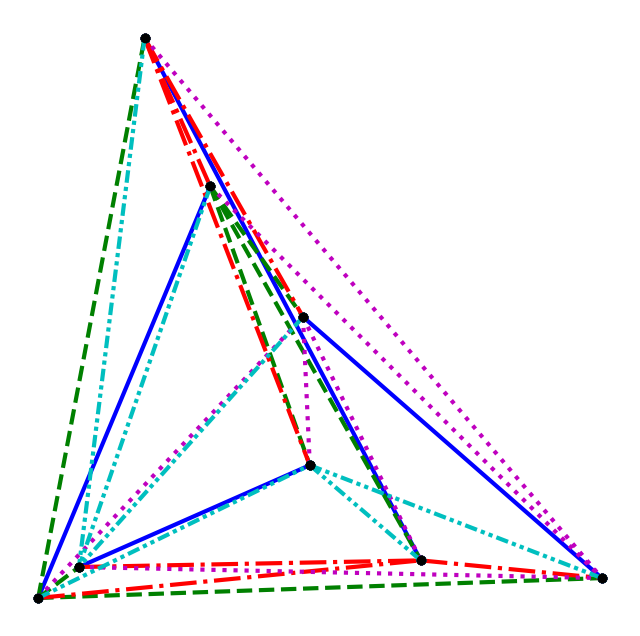

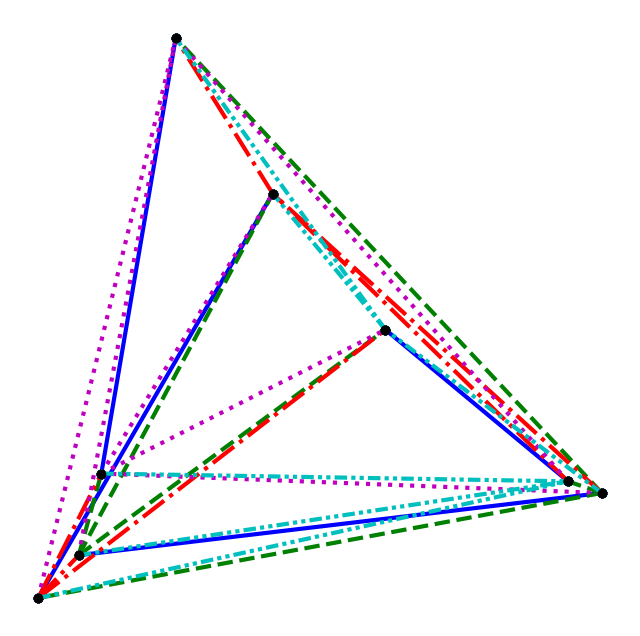

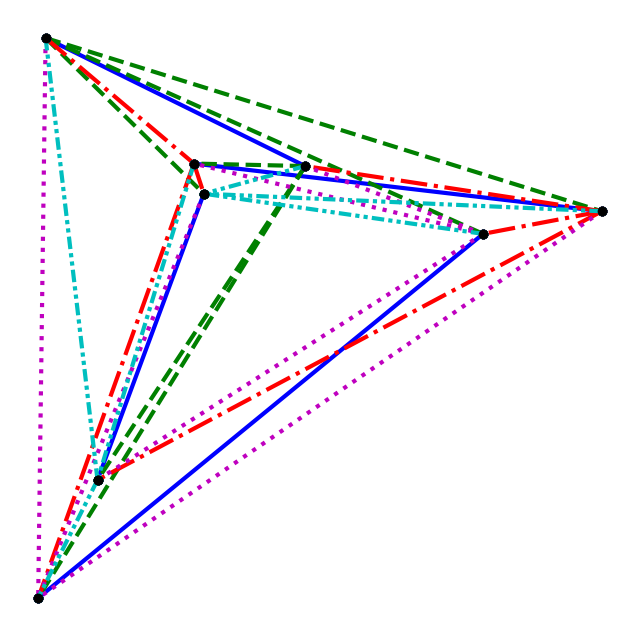

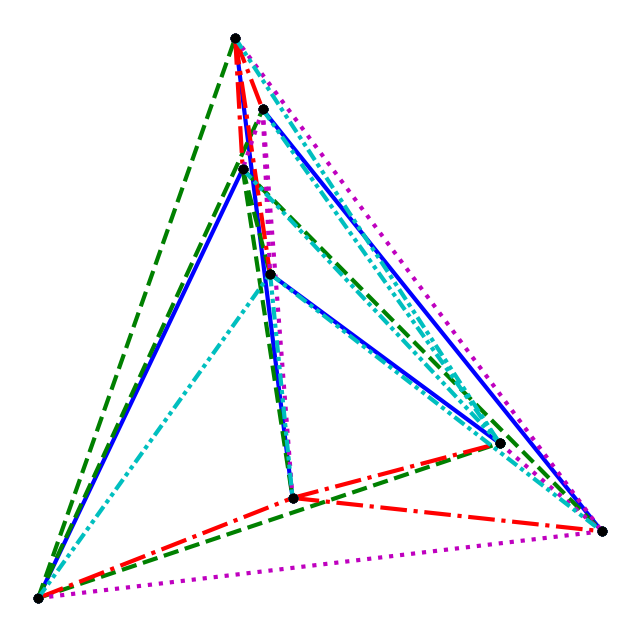

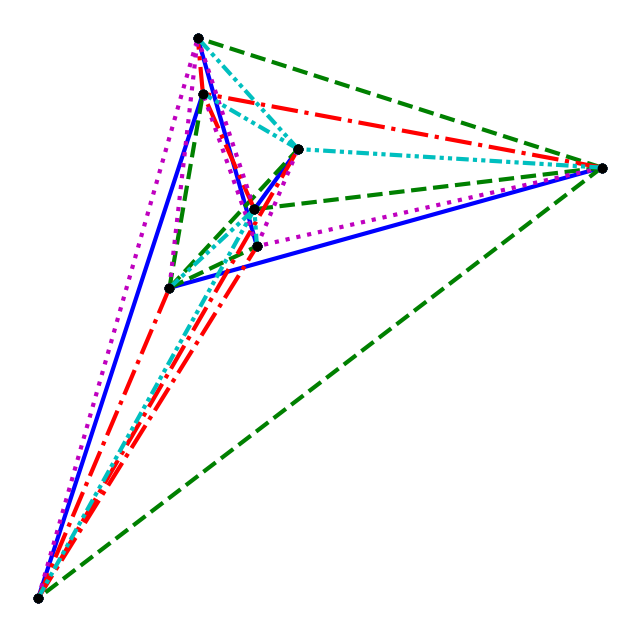

...

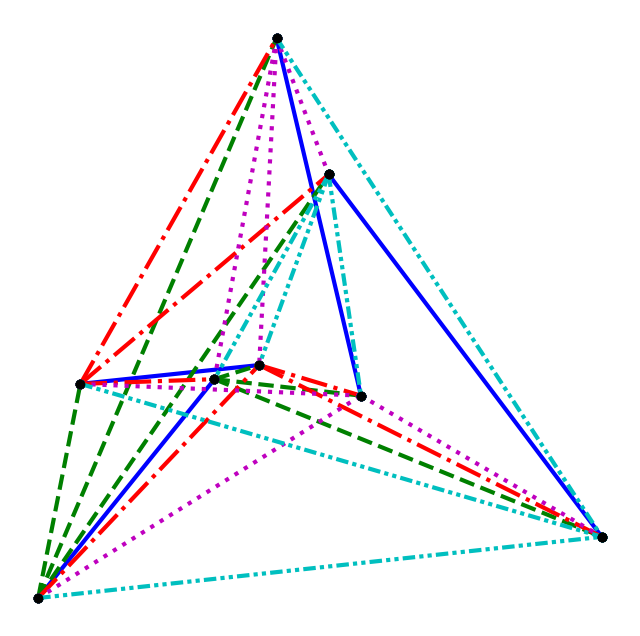

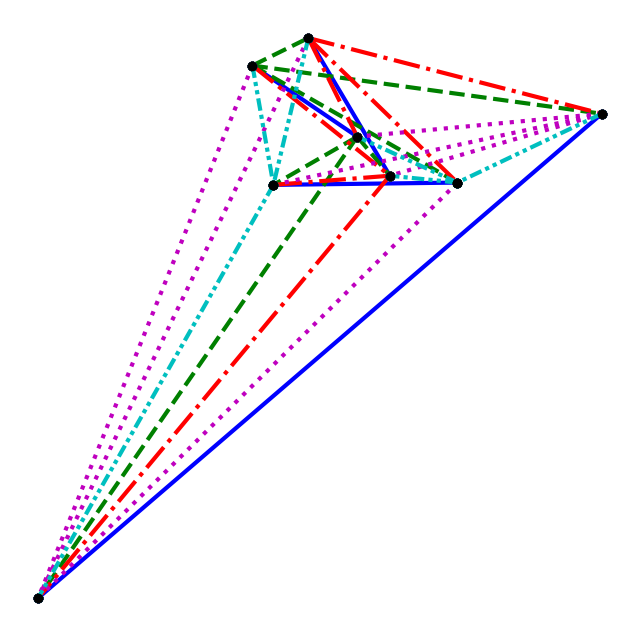

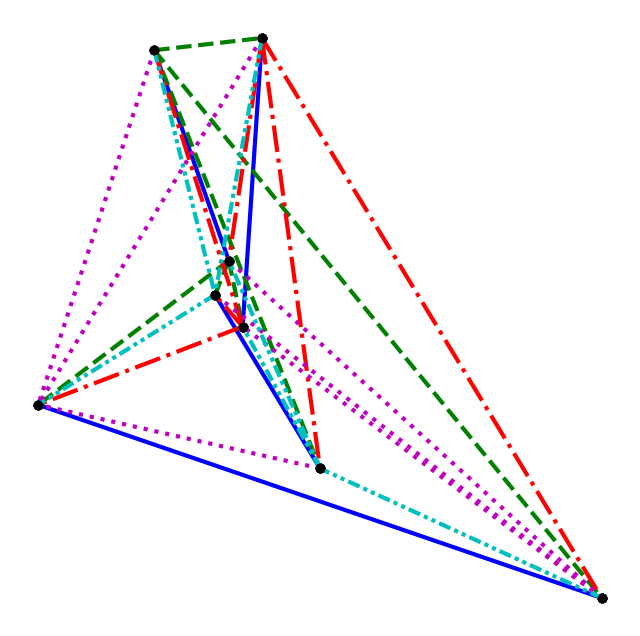

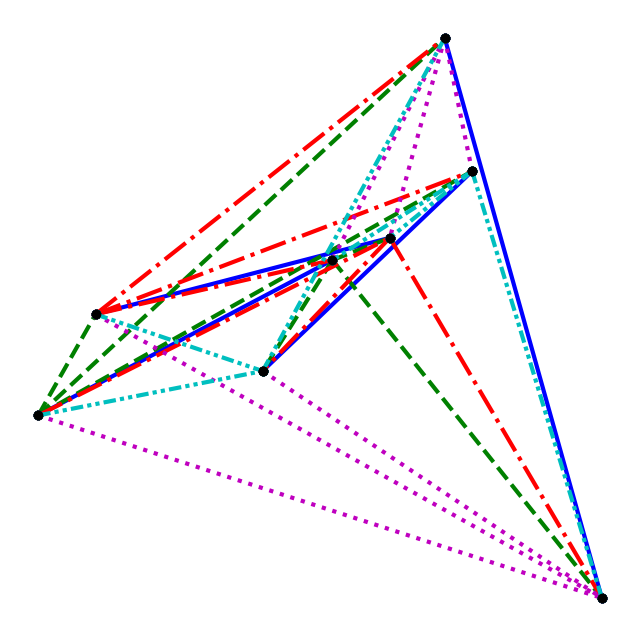

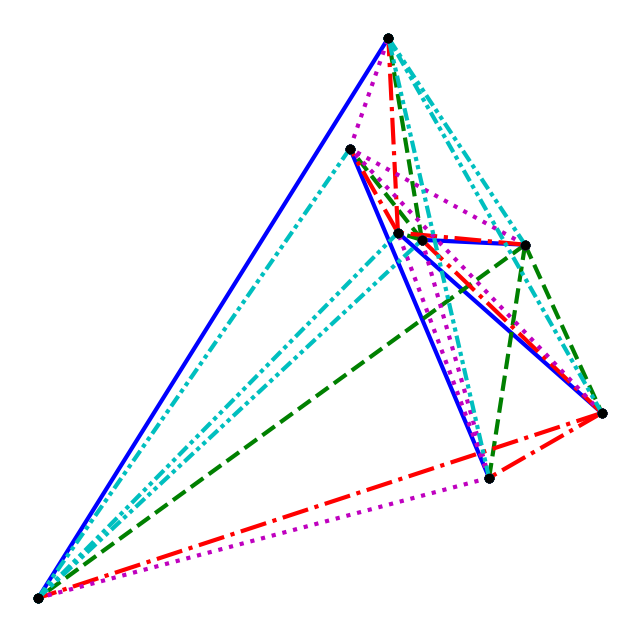

In [ ]:
for p in partitions:
  plot_edges(p[1],p[0])